# Long notebook for group 16

**Kaggle competition**: *Moscow Housing*

**Kaggle team name**: *Team 16*

**Team members**: name - studentId
- Laure Beringer - 
- Hasse Rombouts - 
- Henrik Fjellheim - 490763


In this notebook we will present all important experiments we've tried for the project of the TDT4173 Machine Learning course.  
The notebook will present the following:
1. [EDA](#eda)
2. [Feature Engineering](#featureEngineering)
2. [Models](#models)
3. [Ensemble of models](#ensemble-of-models)


Imports and main common functions:

In [251]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import RandomForestRegressor
from scipy import stats
import json
import seaborn as sns

import plotly.express as px
import matplotlib.pylab as plt
plt.style.use('ggplot')

def root_mean_squared_log_error(y_true, y_pred):
    # Alternatively: sklearn.metrics.mean_squared_log_error(y_true, y_pred) ** 0.5
    assert (y_true >= 0).all() 
    assert (y_pred >= 0).all()
    log_error = np.log1p(y_pred) - np.log1p(y_true)  # Note: log1p(x) = log(1 + x)
    return np.mean(log_error ** 2) ** 0.5

## EDA

This part will contain :
1. [Loading and describing the data](#loading-and-description-of-the-data)
2. [Further investigation and data cleaning]()
3. [Handling missing values](#missing-values)
4. [Feature engineering](#feature-engineering)

### Loading and description of the data

#### Loading

Loading and merging of the data:

In [252]:
# Reading the datasets
# Metadata
metaData_apartment = pd.read_json('data/apartments_meta.json')
metaData_building = pd.read_json('data/buildings_meta.json')
metaData = pd.concat([metaData_apartment, metaData_building])

# train
train_apartment = pd.read_csv('data/apartments_train.csv')
train_building = pd.read_csv('data/buildings_train.csv')
df_train = pd.merge(train_apartment, train_building, left_on='building_id', right_on='id')
df_train.rename(columns={'id_x' : 'apartment_id'}, inplace=True)
df_train.drop('id_y', axis=1, inplace=True)

# test
test_apartment = pd.read_csv('data/apartments_test.csv')
test_building = pd.read_csv('data/buildings_test.csv')
df_test = pd.merge(test_apartment, test_building, left_on='building_id', right_on='id')
df_test.rename(columns={'id_x' : 'apartment_id'}, inplace=True)
df_test.drop('id_y', axis=1, inplace=True)

df_all = pd.concat([df_train, df_test])

Some basic information about the data:

In [119]:
print('Number of Training Examples = {}'.format(df_train.shape[0]))
print('Number of Test Examples = {}\n'.format(df_test.shape[0]))
print('Training X Shape = {}'.format(df_train.shape))
print('Training y Shape = {}\n'.format(df_train['price'].shape[0]))
print('Test X Shape = {}'.format(df_test.shape))
print('Test y Shape = {}\n'.format(df_test.shape[0]))
print('Train columns \n', list(df_train.columns))
print('Test columns \n', list(df_test.columns))

Number of Training Examples = 23285
Number of Test Examples = 9937

Training X Shape = (23285, 34)
Training y Shape = 23285

Test X Shape = (9937, 33)
Test y Shape = 9937

Train columns 
 ['apartment_id', 'seller', 'price', 'area_total', 'area_kitchen', 'area_living', 'floor', 'rooms', 'layout', 'ceiling', 'bathrooms_shared', 'bathrooms_private', 'windows_court', 'windows_street', 'balconies', 'loggias', 'condition', 'phones', 'building_id', 'new', 'latitude', 'longitude', 'district', 'street', 'address', 'constructed', 'material', 'stories', 'elevator_without', 'elevator_passenger', 'elevator_service', 'parking', 'garbage_chute', 'heating']
Test columns 
 ['apartment_id', 'seller', 'area_total', 'area_kitchen', 'area_living', 'floor', 'rooms', 'layout', 'ceiling', 'bathrooms_shared', 'bathrooms_private', 'windows_court', 'windows_street', 'balconies', 'loggias', 'condition', 'phones', 'building_id', 'new', 'latitude', 'longitude', 'district', 'street', 'address', 'constructed', 'mater

#### Description

Functions to describe each colmuns of the data using the metadata:

In [120]:
def describe_column(meta):
    """
    Utility function for describing a dataset column (see below for usage)
    """
    def f(x):
        d = pd.Series(name=x.name, dtype=object)
        m = next(m for m in meta if m['name'] == x.name)
        d['Type'] = m['type']
        d['#NaN'] = x.isna().sum()
        d['Description'] = m['desc']
        if m['type'] == 'categorical':
            counts = x.dropna().map(dict(enumerate(m['cats']))).value_counts().sort_index()
            d['Statistics'] = ', '.join(f'{c}({n})' for c, n in counts.items())
        elif m['type'] == 'real' or m['type'] == 'integer':
            stats = x.dropna().agg(['mean', 'std', 'min', 'max'])
            d['Statistics'] = ', '.join(f'{s}={v :.1f}' for s, v in stats.items())
        elif m['type'] == 'boolean':
            counts = x.dropna().astype(bool).value_counts().sort_index()
            d['Statistics'] = ', '.join(f'{c}({n})' for c, n in counts.items())
        else:
            d['Statistics'] = f'#unique={x.nunique()}'
        return d
    return f

def describe_data(data, meta):
    desc = data.apply(describe_column(meta)).T
    desc = desc.style.set_properties(**{'text-align': 'left'})
    desc = desc.set_table_styles([ dict(selector='th', props=[('text-align', 'left')])])
    return desc 

Description of the apartment data:

In [121]:
print(f'Loaded {len(train_apartment)} apartments')
# metadata as json
with open('data/apartments_meta.json') as f: 
    apartments_meta = json.load(f)
describe_data(train_apartment, apartments_meta)

Loaded 23285 apartments


,Type,#NaN,Description,Statistics
id,integer_id,0,Unique ID for apartment,#unique=23285
seller,categorical,8830,The type of apartment seller,"Agents(1895), Company(4768), Developer(6185), Owner(1607)"
price,real,0,The listed price of the apartment (TARGET),"mean=23556173.5, std=52643927.8, min=900000.0, max=2600000000.0"
area_total,real,0,Total area of the apartment,"mean=74.5, std=58.7, min=9.3, max=2181.0"
area_kitchen,real,4721,Total kitchen area in the apartment,"mean=12.6, std=6.6, min=1.0, max=100.0"
area_living,real,3882,Total living space area in the apartment,"mean=38.7, std=31.4, min=0.0, max=900.0"
floor,integer,0,Primary building floor of the apartment,"mean=9.0, std=8.3, min=1.0, max=95.0"
rooms,integer,0,Number of rooms in the apartment,"mean=2.2, std=1.1, min=1.0, max=6.0"
layout,categorical,17642,Overal apartment layout,"Adjacent(241), Adjacent_isolated(465), Isolated(4937)"
ceiling,real,11093,Ceiling height in the apartment,"mean=3.3, std=10.8, min=0.0, max=340.0"


We can see that the features with no nan values are : id, price, area_total, floor, rooms and building_id.  
The categorical features of the apartments are : seller, layout and condition.

Description of the building data:

In [122]:
print(f'Loaded {len(train_building)} building')
# metadata as json
with open('data/buildings_meta.json') as f: 
    building_meta = json.load(f)
describe_data(train_building, building_meta)

Loaded 6791 building


,Type,#NaN,Description,Statistics
id,integer_id,0,Unique ID of building for joining with apartments,#unique=6791
new,boolean,227,Whether it is an old or new building,"False(6141), True(423)"
latitude,real,0,Latitude coordinate of building,"mean=55.7, std=0.1, min=55.2, max=56.0"
longitude,real,0,Longitude coordinate of building,"mean=37.6, std=0.2, min=36.9, max=38.0"
district,categorical,1,Administriative district within Moscow,"Central(637), East(956), North(593), North-East(630), North-West(553), Novomoskovsk(344), South(758), South-East(672), South-West(900), Troitsk(146), West(535), Zelenograd(66)"
street,string,0,Bulding street name,#unique=1682
address,string,0,Building address (within street),#unique=1851
constructed,integer,479,Year when the building was constructed,"mean=1985.8, std=24.3, min=1855.0, max=2023.0"
material,categorical,1165,Primary building material used in building,"Block(679), Bricks(1226), Monolith(1312), Monolithic_brick(19), Panel(2384), Stalin_project(2), Wood(4)"
stories,integer,0,Total number of floors in the building,"mean=13.0, std=7.0, min=1.0, max=95.0"


We can see that the features with no nan values are : id, latitude, longitude, street, address and stories.  
The categorical features of the building data are : district, material, parking and heating

#### First plots

##### Histograms to get an overview
Initially a the histogram of all features were plotted, giving an overview of the data and what to expect from the features. Some immediate points of concern where noted right away.

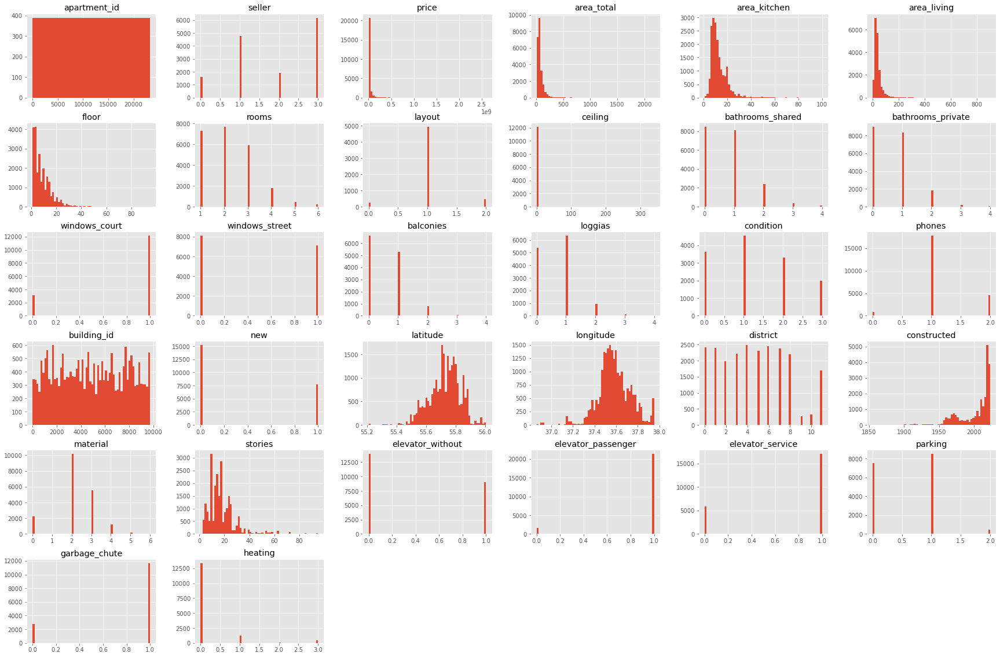

In [123]:
#df_train[["area_total", "area_living", "area_kitchen", "ceiling", "latitude", "longitude"]].hist(bins=60, figsize=(30,7))
df_train.hist(bins=60, figsize=(30,20))
plt.show()

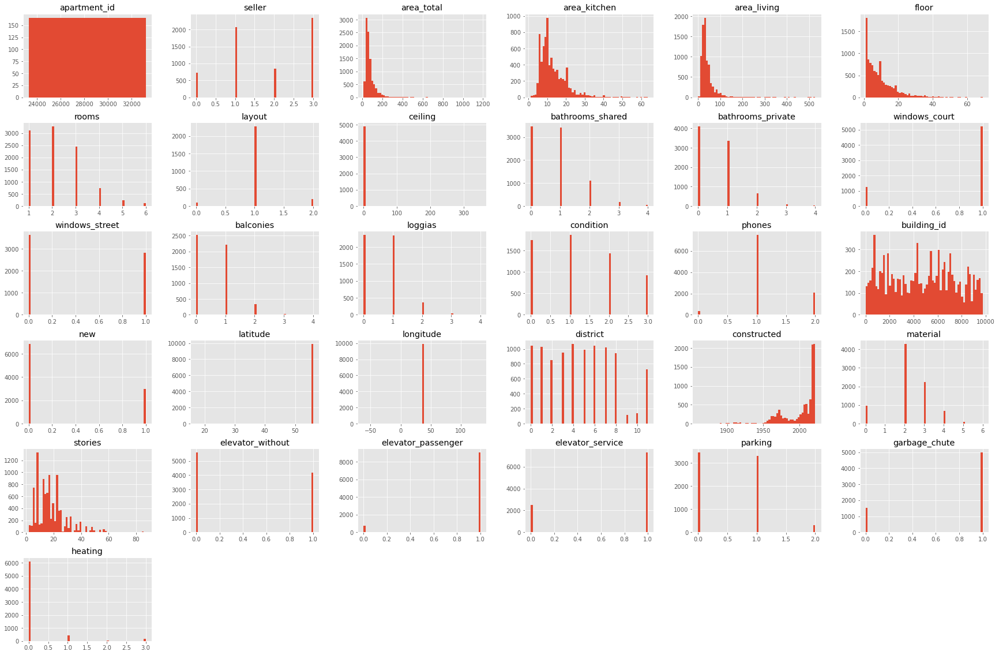

In [124]:
df_test.hist(bins=60, figsize=(30,20))
plt.show()

#### Immediate notes of concern
- The price distribution is heavily skewed. There are appartments in the dataset with a very high price. This is probably the reason for using the RSMLE loss function on our predictions, instead of the standard RMSE.
- Area-data seems to contain some outliers, probably some huge luxury appartments, which heavily skew the histogram. A possible solution for this might be to use logged values of the areas instead.
- Ceiling data for both training and testing data has some super-wide outlayers. It looks like some ceilings are above 300 meters. We will need to look into that.
- While longitude and lattitude seems to have a gaussian distribution for train data, in the testing data there seems to be something off

#### Looking at NaN-distributions
In addition to checking the histograms, looking at the NaN percentages of each features is a good place to start. We see that many features have more than 50% NaN rate, and we will have to be creative if we are to use these effectively. Useful is that both the training and testing dataset typically have a similar NaN rate.

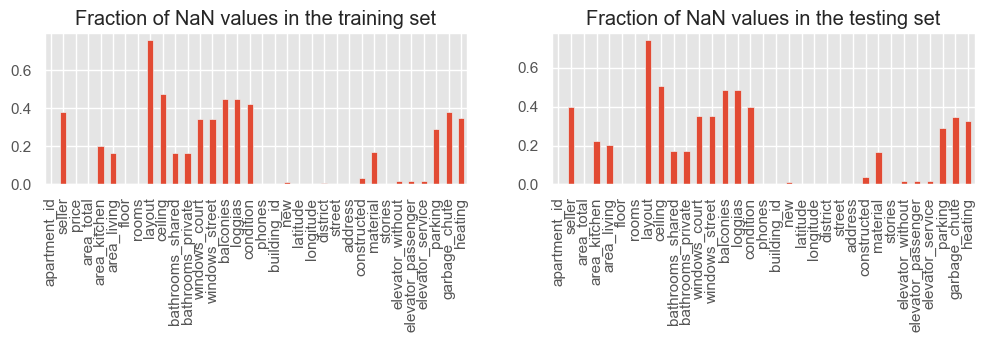

In [98]:
fig, (ax1, ax2) = plt.subplots(figsize=(12, 2), ncols=2, dpi=100)
df_train.isna().mean().plot.bar(ax=ax1, title='Fraction of NaN values in the training set')
df_test.isna().mean().plot.bar(ax=ax2, title='Fraction of NaN values in the testing set');

#### Plot the total correlation map
Knowing what correlates and not will be helpful, both for engineering new features - but also for filling nans!

<AxesSubplot:>

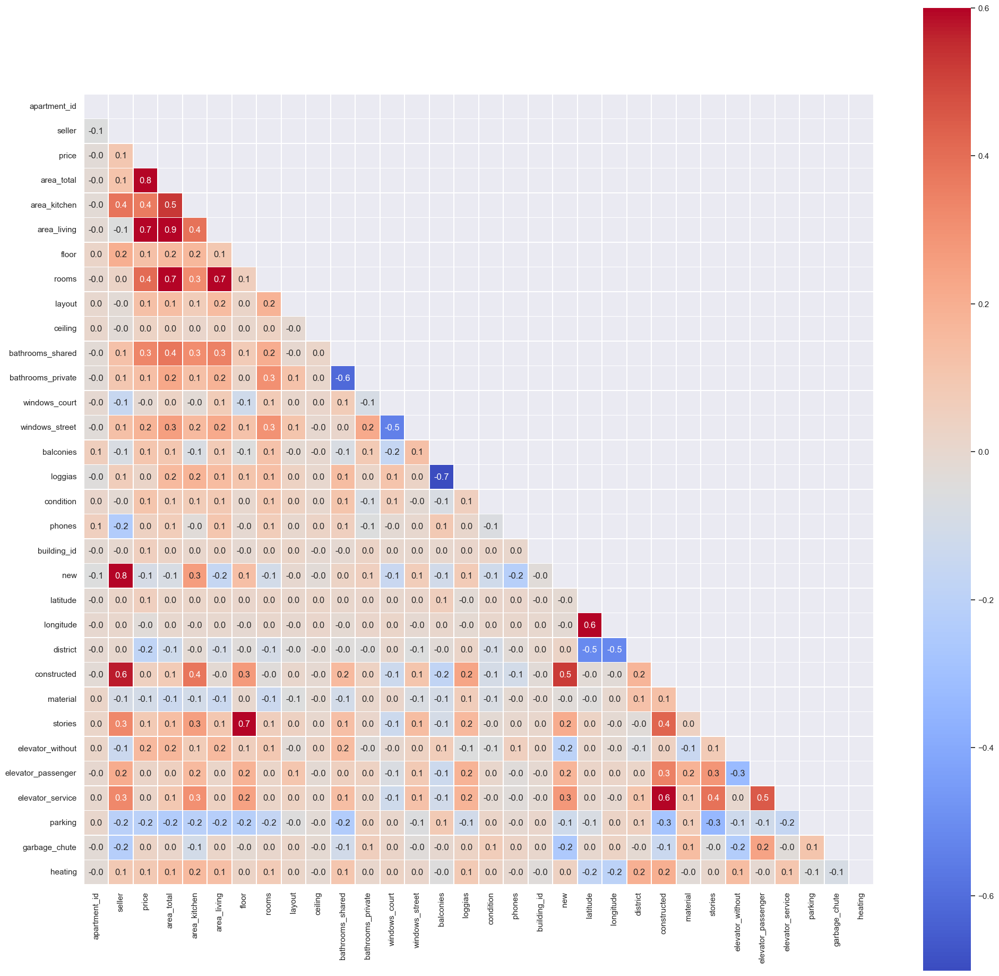

In [30]:
# Compute the correlation matrix
corr = df_all.corr()
# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))
# Set up the matplotlib figure
f, ax1 = plt.subplots(figsize=(24, 24), dpi=100)
# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)
# Draw the heatmap with the mask and correct aspect ratio
sns.set_theme(style="dark")
sns.heatmap(corr, mask=mask, vmax=0.6, square=True, cmap='coolwarm', annot=True, linewidths=.5, fmt= '.1f',ax=ax1)

### Further exploring of features and data cleaning

#### Price distribution
The price distribution in training data contains a lot of outliers, as for the area data, skewing the graph heavily.
We know that an "Root mean squared **logarithic** error" function is going to be used for the loss of this competition, so missing some of the outliers in our prediction wont be that impactful on our score.

*In case we are going to train any models, without the RMSLE loss metric/evaluation/score - we will need to manually log the price before passing it to the model.*

In [141]:
logged_price = np.log(df_train["price"])

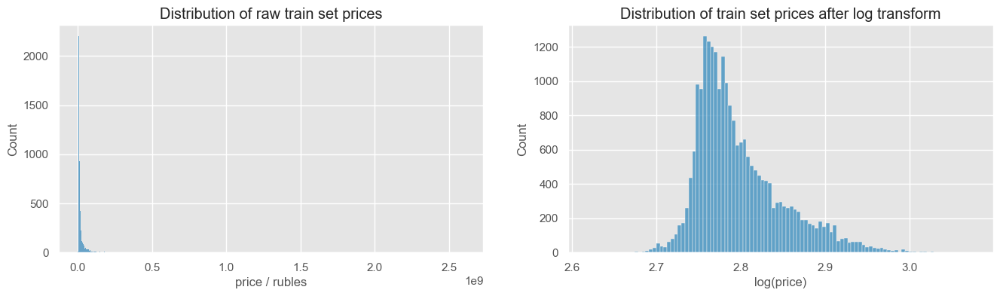

In [101]:
fig, (ax1, ax2) = plt.subplots(figsize=(16, 4), ncols=2, dpi=100)
sns.histplot(df_train.price.rename('price / rubles'), ax=ax1)
ax1.set_title('Distribution of raw train set prices')
sns.histplot(np.log(logged_price).rename('log(price)'), ax=ax2)
ax2.set_title('Distribution of train set prices after log transform');

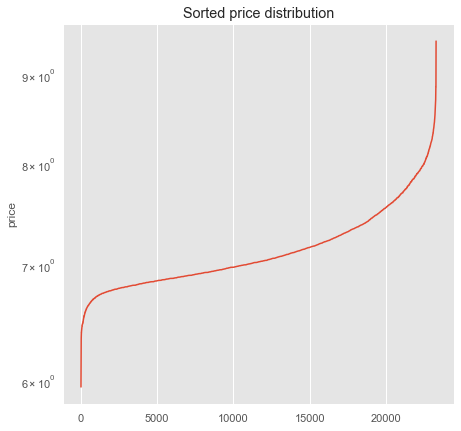

In [103]:
price_sorted = df_train['price'].sort_values(ignore_index=True)
price_sorted.head()
f, ax = plt.subplots(figsize=(7, 7))
ax.set(yscale="log")
ax.set_title('Sorted price distribution')
plot1 = sns.lineplot(data=price_sorted, ax=ax)

#### Area data
Lets now look at area data. We will first log() it, to get a more even distribution.

In [253]:
df_train[["area_total", "area_living", "area_kitchen"]] = np.log1p(df_train[["area_total", "area_living", "area_kitchen"]])
df_test[["area_total", "area_living", "area_kitchen"]] = np.log1p(df_test[["area_total", "area_living", "area_kitchen"]])

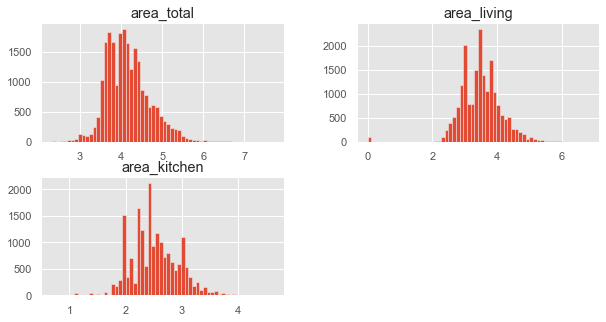

In [143]:
df_train[["area_total", "area_living", "area_kitchen"]].hist(bins=60, figsize=(10, 5));

**Area_living**: Then we will look at some correlation between the different areas. From the correlation map above we see some clear correlation between `area_total` and `area_living` (0.9!) If we see a good correlation we could use `area_total` to fillnans of `area_living`. 

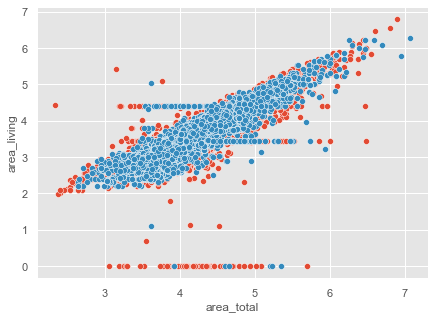

In [144]:
plt.figure(figsize=(7, 5))
sns.scatterplot(data=df_train, x="area_total", y="area_living")
sns.scatterplot(data=df_test, x="area_total", y="area_living")
plt.show()

**Alright** that is indeed a good correlation, but we notice two things we need to fix right away:
- There are **zero** values in the `area_living` dataset. This can be fixed by using the correlated area_total to move the zeroes to a more reasonable position. Area_total also has no nans itself, so this should be possible
- Some apartments have more `area_living` than what they have `area_total`. This is also unrealistic, and will be fixed 

In [254]:
# Replace the zeroes in area_living with expected values based on the area_total of the apartment
remove_zero = [row["area_living"] if row["area_living"] > 0 else row["area_total"]*(df_train["area_living"].mean() / df_train["area_total"].mean()) for _, row in df_train.iterrows()] 
df_train["area_living"] = remove_zero

remove_zero = [row["area_living"] if row["area_living"] > 0 else row["area_total"]*(df_test["area_living"].mean() / df_test["area_total"].mean()) for _, row in df_test.iterrows()] 
df_test["area_living"] = remove_zero

In [255]:
remove_upper_stripe = [row["area_living"] if row["area_living"] < row["area_total"] else row["area_total"]*(df_train["area_living"].mean() / df_train["area_total"].mean()) for _, row in df_train.iterrows()] 
df_train["area_living"] = remove_upper_stripe

remove_upper_stripe = [row["area_living"] if row["area_living"] < row["area_total"] else row["area_total"]*(df_test["area_living"].mean() / df_test["area_total"].mean()) for _, row in df_test.iterrows()] 
df_test["area_living"] = remove_upper_stripe

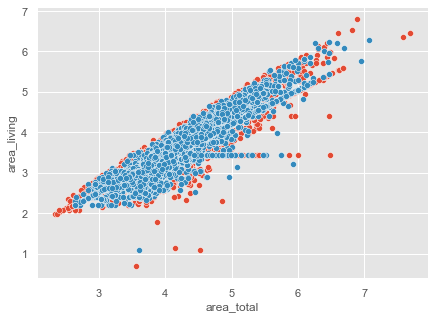

In [168]:
plt.figure(figsize=(7, 5))
sns.scatterplot(data=df_train, x="area_total", y="area_living")
sns.scatterplot(data=df_test, x="area_total", y="area_living")
plt.show()

**Now that is better**: now we can move on to filling the nans of area-living, based on its correlation to area_total, which is without nans.

In [149]:
# A function that fits a linear regression between features, and uses it to fill nans
from sklearn.linear_model import LinearRegression
def fillnaReg(df, X_features, y_feature):
    df = df.copy()
    df_temp = df[df[y_feature].notna()]
    if df_temp.shape[0] == 1: df_temp = df_temp.values.reshape(-1, 1)
    reg = LinearRegression().fit(df_temp[X_features], df_temp[y_feature])
    predict = reg.predict(df[X_features])
    df[y_feature] = np.where(df[y_feature]>0, df[y_feature], predict)
    return df

In [256]:
df_train = fillnaReg(df_train, ['area_total'], 'area_living')
df_test = fillnaReg(df_test, ['area_total'], 'area_living')

In [257]:
display(df_train["area_living"].isna().sum())
display(df_test["area_living"].isna().sum())

0

0

**Area_kitchen** is also heavily correlated to both area_total (0.5) and area_living (0.4) (from correlation plot).

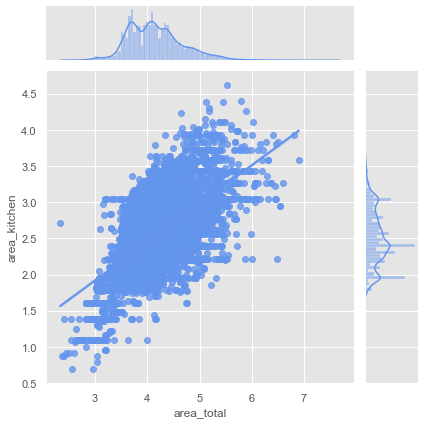

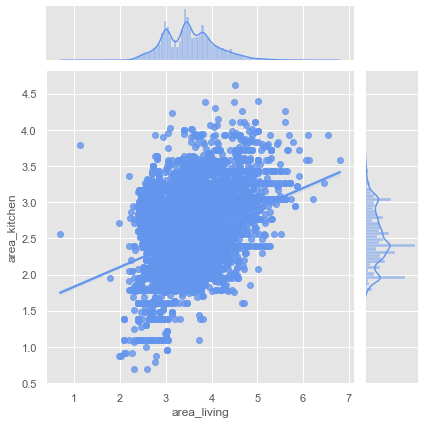

In [173]:
sns.jointplot(x=df_train.loc[:,'area_total'], y=df_train.loc[:,'area_kitchen'], ax=ax1, kind="reg", color="#6495ED")
sns.jointplot(x=df_train.loc[:,'area_living'], y=df_train.loc[:,'area_kitchen'], ax=ax2, kind="reg", color="#6495ED")

*but* we dont see the same strong correlation as we saw between the `area_total` and `area_living`. What about all three at the same time?

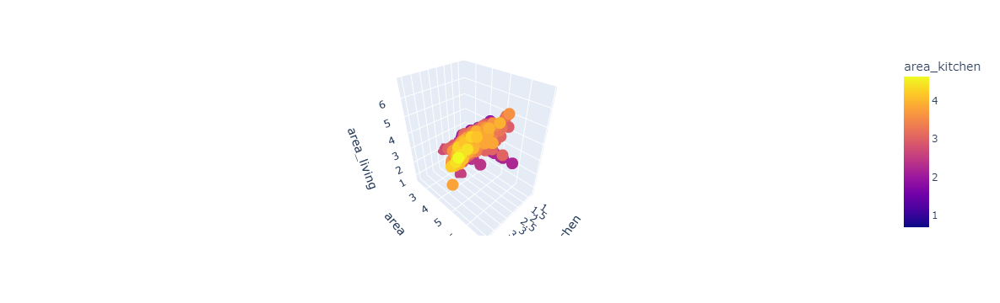

In [174]:
fig = px.scatter_3d(df_train, x='area_kitchen', y='area_total', z='area_living',
              color='area_kitchen')
fig.show()

We can clearly see that all the three features are located on the **same plane**. We can then deduce the missing values of the feature `area_kitchen` with the values of the features `area_total` and `area_living`, using the same fillnaReg() function from earlier

In [258]:
df_train = fillnaReg(df_train, ['area_total', 'area_living'], 'area_kitchen')
df_test = fillnaReg(df_test, ['area_total', 'area_living'], 'area_kitchen')

In [176]:
display(df_train["area_kitchen"].isna().sum())
display(df_test["area_kitchen"].isna().sum())

0

0

#### Apartments position and price
Let's take a closer look at the longitude and latitude data. There are obviously some apartments of the testing data, that are not positioned placed in Moscow at all. We will not be able to drop them from the dataset, but we will see if we can do something about them.

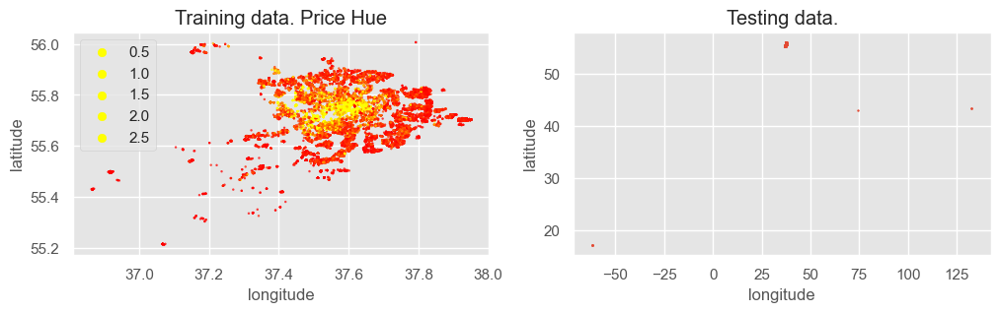

In [259]:
fig, (ax1, ax2) = plt.subplots(figsize=(12, 3), ncols=2, dpi=100)
lo, hi = df_train["price"].quantile([0.1, 0.8])
hue_norm = plt.Normalize(lo, hi)
hue = df_train["price"].tolist()

ax1.set_title("Training data. Price Hue")
ax2.set_title("Testing data.")
sns.scatterplot(x='longitude', y='latitude', ax=ax1, hue=hue, alpha=0.75, s=3, palette="autumn", linewidth=0, hue_norm=hue_norm, data=df_train[['latitude', 'longitude']])
sns.scatterplot(x='longitude', y='latitude', ax=ax2, alpha=1, s=3, palette="autumn", linewidth=0, data=df_test[['latitude', 'longitude']]);

#### Let us clean up the testing data: longitude and lattitude
*WE can start* by moving the homes off the north pole, atlantic ocean, baltic ocean, and back to Moscow.

In [260]:
# Find houses on the north pole
is_outlier = (df_test["longitude"] > 39) | (df_test["longitude"] < 35)
outliers = df_test.copy()[is_outlier]
outliers[["longitude", "latitude", "district", "street"]]

,longitude,latitude,district,street
7010,-61.790500,17.141734,NaN,Бунинские Луга ЖК
7011,-61.790500,17.141734,NaN,Бунинские Луга ЖК
7033,74.517184,42.914700,NaN,улица 1-я Линия
8320,132.768097,43.353545,NaN,улица Центральная
8518,-61.790500,17.141734,NaN,Бунинские Луга ЖК
8519,-61.790500,17.141734,NaN,Бунинские Луга ЖК
9867,132.759204,43.352968,NaN,улица Центральная


We cannot use the district information to replace these building, and have to rely on using the street names instead. Using **Google maps** we see that both `Бунинские Луга ЖК` (37.482297, 55.543673) and `улица Центральная` (37.640383, 55.566131) are streets in Moscow, but not `улица 1-я Линия`, which indeed seems misplaced. We will fill in the long/lats, and also fix the street which is misplaced.

In [261]:
# Find the most popular street
df_test.street.value_counts().head(1)

Ленинский проспект    201
Name: street, dtype: int64

In [262]:
for index in outliers.index:
    if df_test.loc[index,['street']][0]=="Бунинские Луга ЖК":
        print("Бунинские Луга ЖК")
        df_test.loc[index,['longitude']] = 37.482297
        df_test.loc[index,['latitude']] = 55.543673
    elif df_test.loc[index,['street']][0]=="улица Центральная":
        print("улица Центральная")
        df_test.loc[index,['longitude']] = 37.640383
        df_test.loc[index,['latitude']] = 55.566131
    else:
        df_test.loc[index,['longitude']] = df_train["longitude"].mean()
        df_test.loc[index,['latitude']] = df_train["latitude"].mean()
        df_test.loc[index,['street']] = "Ленинский проспект"

Бунинские Луга ЖК
Бунинские Луга ЖК
улица Центральная
Бунинские Луга ЖК
Бунинские Луга ЖК
улица Центральная


In [263]:
df_test.loc[outliers.index,["longitude", "latitude", "district", "street"]]

,longitude,latitude,district,street
7010,37.482297,55.543673,NaN,Бунинские Луга ЖК
7011,37.482297,55.543673,NaN,Бунинские Луга ЖК
7033,37.583425,55.728337,NaN,Ленинский проспект
8320,37.640383,55.566131,NaN,улица Центральная
8518,37.482297,55.543673,NaN,Бунинские Луга ЖК
8519,37.482297,55.543673,NaN,Бунинские Луга ЖК
9867,37.640383,55.566131,NaN,улица Центральная


**Now that is more realistic**, before moving on however, we need to fill some nan values in long/lat

In [264]:
display(df_test[["longitude", "latitude"]].isna().sum())
display(df_train[["longitude", "latitude"]].isna().sum())

longitude    2
latitude     2
dtype: int64

longitude    0
latitude     0
dtype: int64

In [265]:
is_na = (df_test["longitude"].isna())
nas = df_test.copy()[is_na]
nas[["longitude", "latitude", "district", "street"]]

,longitude,latitude,district,street
220,NaN,NaN,NaN,пос. Коммунарка
221,NaN,NaN,NaN,пос. Коммунарка


**Again** this is a Moscow street with a known location: (37.470959, 55.570540)

In [266]:
df_test.loc[nas.index,['longitude']] = 37.470959
df_test.loc[nas.index,['latitude']] = 55.570540

In [268]:
df_test.loc[nas.index,["longitude", "latitude", "district", "street"]]

,longitude,latitude,district,street
220,37.470959,55.57054,NaN,пос. Коммунарка
221,37.470959,55.57054,NaN,пос. Коммунарка


**Let us now go back to the city-plot** and see if it has improved:

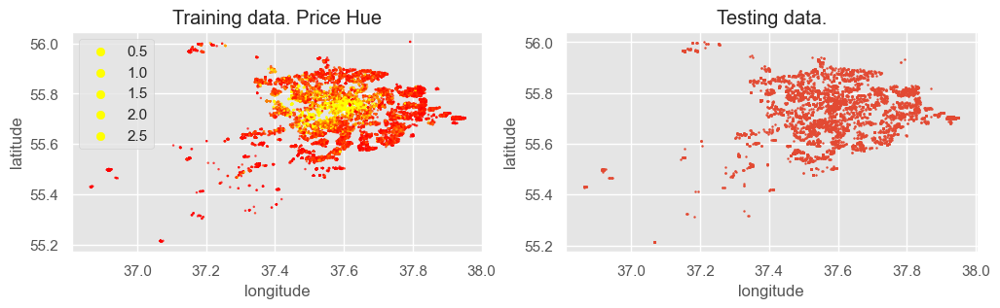

In [269]:
fig, (ax1, ax2) = plt.subplots(figsize=(12, 3), ncols=2, dpi=100)
lo, hi = df_train["price"].quantile([0.1, 0.8])
hue_norm = plt.Normalize(lo, hi)
hue = df_train["price"].tolist()

ax1.set_title("Training data. Price Hue")
ax2.set_title("Testing data.")
sns.scatterplot(x='longitude', y='latitude', ax=ax1, hue=hue, alpha=0.75, s=3, palette="autumn", linewidth=0, hue_norm=hue_norm, data=df_train[['latitude', 'longitude']])
sns.scatterplot(x='longitude', y='latitude', ax=ax2, alpha=1, s=3, palette="autumn", linewidth=0, data=df_test[['latitude', 'longitude']]);

**It really has improved!** - Now it is easier to see that the distribution between the two is pretty similar, and in the same area.

#### District nans
These nans can be eaily be filled using long/lat data from the row. We calculate the mean long, lat for each district and for each nan value in district we place it in the **closest one**.

In [270]:
print(df_test["district"].isna().sum())
print(df_train["district"].isna().sum())

25
130


In [271]:
import math
def closest_district(lat, long, district_centre_long, district_centre_lat):
    best_distance = -1
    closest_dist = -1
    for i in range(len(district_centre_long)):
        long_dist =  district_centre_long[i][0]
        lat_dist = district_centre_lat[i][0]
        total_dist = np.sqrt((long-long_dist)**2 + (lat-lat_dist)**2)
        if total_dist < best_distance or best_distance==-1:
            best_distance = total_dist
            closest_dist = i
    return closest_dist

In [272]:
# Fill districts using long/lat
district_centre_long = np.array(df_train[["district", "longitude"]].groupby(['district']).mean())
district_centre_lat = np.array(df_train[["district", "latitude"]].groupby(['district']).mean())

remove_nan_districts = [closest_district(row["latitude"],
 row["longitude"], district_centre_long, district_centre_lat) if math.isnan(row["district"]) else row["district"] for _, row in df_train.iterrows()] 
df_train["district"] = remove_nan_districts

remove_nan_districts = [closest_district(row["latitude"],
 row["longitude"], district_centre_long, district_centre_lat) if math.isnan(row["district"]) else row["district"] for _, row in df_test.iterrows()] 
df_test["district"] = remove_nan_districts

In [273]:
print(df_test["district"].isna().sum())
print(df_train["district"].isna().sum())

0
0


#### Ceiling feature
So, while plotting the histogram for ceiling we got a bit nervous. Lets look more closely at it.

Max values of each 340.0 350.0
Min values of each 0.0 0.0


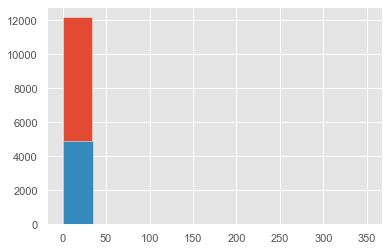

In [274]:
df_train["ceiling"].hist()
df_test["ceiling"].hist()
print("Max values of each", df_train["ceiling"].max(), df_test["ceiling"].max())
print("Min values of each", df_train["ceiling"].min(), df_test["ceiling"].min())

**Two problems:**
- We have a few massive roofs! Need to move these down to the average level.
- We have some 0-height ceilings, that is not realistic, and we also need to move these.

Lets look at **correlation to price**, before and after doing this fix: Before the correlation is only 0.052

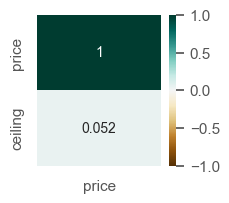

In [275]:
f, ax = plt.subplots(figsize=(2, 2), dpi=100)
heatmap = sns.heatmap(pd.merge(df_train[["ceiling"]], logged_price, left_index=True, right_index=True).corr()[["price"]].sort_values(by="price", ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG', ax=ax)

We replace the obvious otlayers, with the mean value from the non-outlayer data

In [276]:
is_outlier = ((df_train["ceiling"] > 10) | (df_train["ceiling"] < 0.5)) # No roofs should be more than 10 meters, or below 0.5 meters. roughly.
outliers = df_train.copy()[is_outlier]
inliers_index=[]
for index in df_train.index:
    if index not in outliers.index:
        inliers_index.append(index)
df_train.loc[outliers.index,['ceiling']] = df_train.loc[inliers_index,['ceiling']].mean()

is_outlier = ((df_test["ceiling"] > 10) | (df_test["ceiling"] < 0.5))
outliers = df_test.copy()[is_outlier]
for index in df_test.index:
    if index not in outliers.index:
        inliers_index.append(index)
df_test.loc[outliers.index,['ceiling']] = df_test.loc[df_test.index.intersection(inliers_index),['ceiling']].mean()

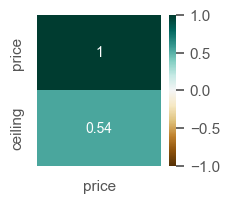

In [277]:
f, ax = plt.subplots(figsize=(2, 2), dpi=100)
heatmap = sns.heatmap(pd.merge(df_train[["ceiling"]], logged_price, left_index=True, right_index=True).corr()[["price"]].sort_values(by="price", ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG', ax=ax)

**Now that is a big improvement** in correlation! From being a useless feature, to being quite relevant in 1-2-3

Max values of each 8.0 7.0
Min values of each 1.65 1.7


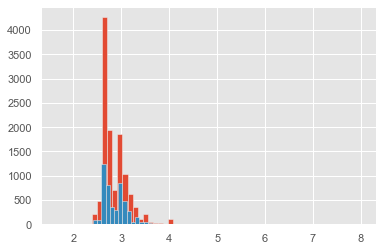

In [278]:
df_train["ceiling"].hist(bins=60)
df_test["ceiling"].hist(bins=60)
print("Max values of each", df_train["ceiling"].max(), df_test["ceiling"].max())
print("Min values of each", df_train["ceiling"].min(), df_test["ceiling"].min())

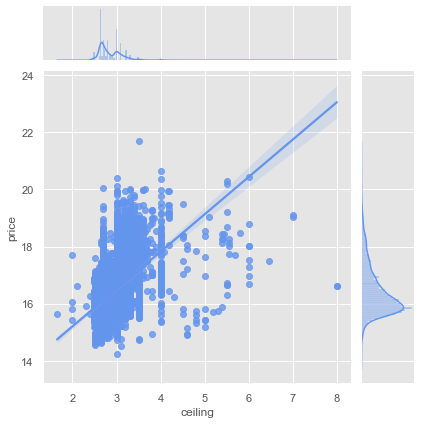

In [279]:
sns.jointplot(x=df_train.loc[:,'ceiling'], y=logged_price, kind="reg", color="#6495ED");

#### Categorical features, filling nans
This is all the non-ordinal categorical features in our data: ["layout", "condition", "district", "material", "parking", "heating", "seller"]. We have already filled the nans that existed in `district`, but for the rest there still remains nans. Let us look at the histogram for these features once more:


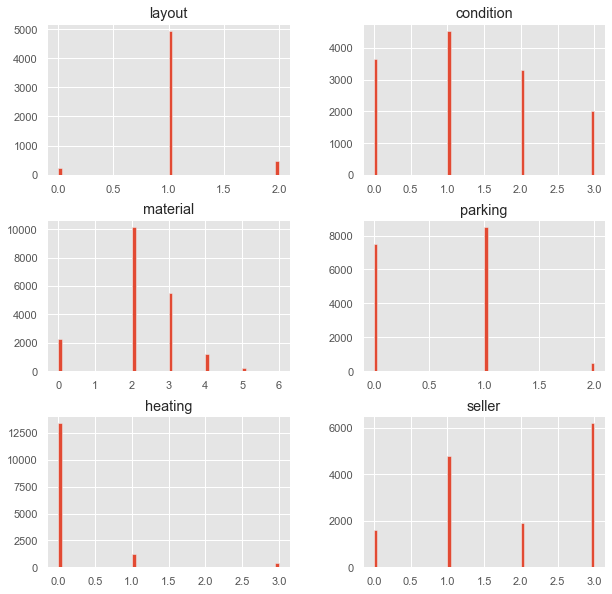

In [280]:
df_train[["layout", "condition", "material", "parking", "heating", "seller"]].hist(bins=60, figsize=(10, 10));

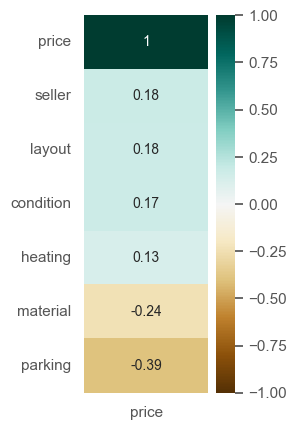

In [281]:
f, ax = plt.subplots(figsize=(2, 5), dpi=100)
heatmap = sns.heatmap(pd.merge(df_train[["layout", "condition", "material", "parking", "heating", "seller"]], logged_price, left_index=True, right_index=True).corr()[["price"]].sort_values(by="price", ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG', ax=ax)

**Let us conduct an experiment**: what if we fill the nans with a new "unknown category", will this increase the correlation to price?

In [282]:
df_train_copy = df_train.copy()
df_test_copy = df_test.copy()

In [283]:
for feature in ["layout", "condition", "material", "parking", "heating", "seller"]:
    unknown_category = len(list(df_train_copy[feature].unique())) - 1
    df_train_copy[feature] = df_train_copy[feature].fillna(unknown_category)
    df_test_copy[feature] = df_test_copy[feature].fillna(unknown_category)

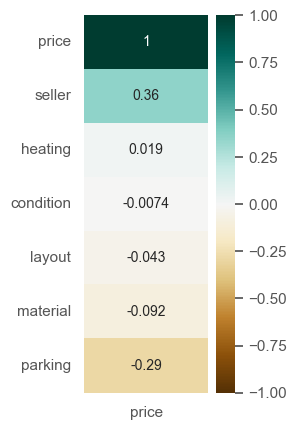

In [285]:
f, ax = plt.subplots(figsize=(2, 5), dpi=100)
heatmap = sns.heatmap(pd.merge(df_train_copy[["layout", "condition", "material", "parking", "heating", "seller"]], logged_price, left_index=True, right_index=True).corr()[["price"]].sort_values(by="price", ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG', ax=ax)

**Interesting!** Only the `seller` becomes more correlated with price adding the unknown category: what does this mean?
> It could mean that `seller` actually has one, or several more unknow categories that is not included in this dataset, so adding this extra category we added represents these extra categories.

> On the other hand, the other categorical data doesnt have any hidden categories, and what we need to do her is just to fill with median() values.

In [287]:
# Add unknown category to seller.
unknown_category = len(list(df_train["seller"].unique())) - 1
df_train[feature] = df_train["seller"].fillna(unknown_category)
df_test[feature] = df_test["seller"].fillna(unknown_category)

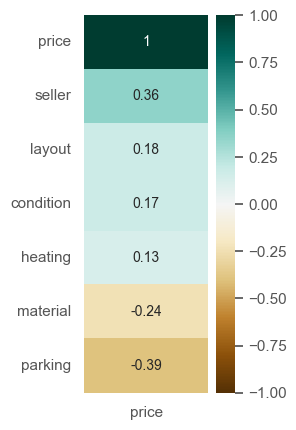

In [288]:
f, ax = plt.subplots(figsize=(2, 5), dpi=100)
heatmap = sns.heatmap(pd.merge(df_train[["layout", "condition", "material", "parking", "heating", "seller"]], logged_price, left_index=True, right_index=True).corr()[["price"]].sort_values(by="price", ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG', ax=ax)

#### People living above their buildings
The `stories` data shows how many stories the building has, while `floor` tells us about what floor the apartment is on. Knowing this, floor should never be more than stories. 

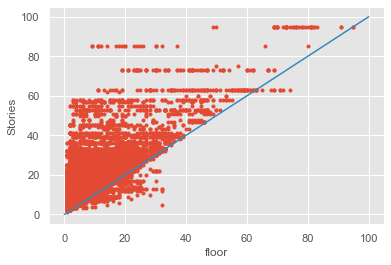

In [354]:
x = np.linspace(0, 100, 100)
y = np.linspace(0, 100, 100)
plt.plot(df_train["floor"], df_train["stories"], ".")
plt.xlabel("floor")
plt.ylabel("Stories")
plt.plot(x, y)
plt.show()

In [356]:
len(df_train[df_train["floor"]>df_train["stories"]])

321

This could either be from something wrong in the building data, being the wrong floor count - or it could be something wrong in the apartments floor count - or it could be something wrong in the apartment_id, linking the two datasets together.

# ---------------------------- THIS IS WHERE HENRIK EDA STOPS ----------------------------
## ------------------------------------------- Pass at your own risk -------------------------------------------

IMO im not sure if everything from here to "missing values section" is needed or not.

In [ ]:
####################################################################################################################################################################

We also developed the following two maps to allow us to interactively play with the location and price of the appartments.

In [21]:
import xyzservices.providers as xyz
from bokeh.plotting import figure, show, output_notebook, ColumnDataSource
from bokeh.tile_providers import CARTODBPOSITRON, get_provider, STAMEN_TERRAIN
from bokeh.models import ColorBar, Select
from bokeh.palettes import Turbo256
from bokeh.transform import linear_cmap, log_cmap
from bokeh.models.widgets import Slider
from bokeh.layouts import row, column

ImportError: cannot import name 'TypeGuard' from 'typing_extensions' (c:\python\python38\lib\site-packages\typing_extensions.py)

In [131]:
#Establishes color palette and data source.
pal= Turbo256

source = ColumnDataSource(data=df_train[['apartment_id', 'price', 'latitude', 'longitude']])

#Establishes color mapper gradient, hover information, and slider widget.
mapper = log_cmap(field_name = "price", palette = pal, low=min(df_train.price), high=max(df_train.price))
tooltips = [("Price","@price")]

#Defines scatter plot attributes and add map tile. Implement colors and data points.
fig = figure(x_axis_type = 'mercator', y_axis_type = 'mercator', tooltips = tooltips, title = 'Moscow Residential Housing Prices')
fig.add_tile(get_provider(STAMEN_TERRAIN))
fig.circle(x = 'longitude', y = 'latitude', line_color = mapper,color=mapper, source=source)

#Defines color bar attributes and location
color_bar = ColorBar(color_mapper=mapper['transform'], width=8, location=(0,0))
fig.add_layout(color_bar, 'right')

#Defines layout of graph and widgets
layout = column(fig)

#Calls figure
show(layout)

Run the code above to have the first map open in a new browser window.

In [132]:
import folium
import math

from folium import Choropleth, Circle, Marker
from folium.plugins import HeatMap, MarkerCluster

In [133]:
map1_df['latitude']

0       -0.184291
1       -0.184291
2       -0.184291
3       -0.184291
4       -0.184291
           ...   
23280   -0.260129
23281   -0.252209
23282    0.011597
23283   -0.193521
23284   -0.078416
Name: latitude, Length: 23285, dtype: float64

In [134]:
def preprocess(df) :
    df = df[['district','latitude','longitude','price']]
    df = df.replace('NA', np.nan)
    df.dropna(subset=['latitude'], inplace=True)
    df.dropna(subset=['price'], inplace=True)
    df["latitude"] = df["latitude"].astype(float)
    df["longitude"] = df["longitude"].astype(float)
    return df

map1_df = preprocess(df_train)

city_map = folium.Map(location=[55.75,37.62], zoom_start=11.2, tiles='Stamen Terrain')
mc = MarkerCluster()
for idx, row in map1_df.iterrows():
    if not math.isnan(row['longitude']) and not math.isnan(row['latitude']):
        popup = """
        District : <b>%s</b><br>
        Price : <b>%s</b><br>
        """ % (row['district'], row['price'])
        mc.add_child(Marker([row['latitude'], row['longitude']],tooltip=popup))
    city_map.add_child(mc)
city_map

#### Comparing Training and Testing Data
We wanted to check a bit further how (dis)similar the train and test datasets are. 
It is easy to plot the distribution of training and testing set against each other using the code below.

In [136]:
x = df_train.drop(['price'],axis=1)
y = df_train['price']
test = df_test

train_true = [1]*len(x.index)
train_false = [0]*len(test.index)

x['train'] = train_true
test['train'] = train_false
concatenated = pd.concat([x,test], sort=False)
concatenated.drop(['street','address'],axis=1,inplace=True)
for column in concatenated.drop(['train'],axis=1).columns:
    # remove kind="kde" to obtain barplots
    sns.displot(concatenated, x=(concatenated[column]), hue="train", kind="kde", fill=True)

We further need to check whether there are id's or categories that do not overlap in the training or testing dataset.

In [137]:
features_to_check = ["apartment_id","building_id","layout", "condition", "district", "material", "parking", "heating", "seller"]

def intersection(lst1, lst2):
    temp = set(lst2)
    lst3 = [value for value in lst1 if value in temp]
    return set(lst3)

for feature in features_to_check:
    n_intersections = len(intersection(list(df_test[feature]),list(df_train[feature])))
    if n_intersections == 0:
        print (feature, " has no overlapping values")
    test_unique = df_test[feature].unique()
    train_unique = df_train[feature].unique()
    only_test = list(set(test_unique).difference(train_unique))
    only_train = list(set(train_unique).difference(test_unique))
    if len(only_test) != 0 and feature not in ['apartment_id','building_id']:
        print("Current feature: ", feature)
        print("These values occur only in the test set: ", only_test)
    if len(only_train) != 0 and feature not in ['apartment_id','building_id']:
        print("Current feature: ", feature)
        print("These values occur only in the train set: ", only_train)

apartment_id  has no overlapping values
building_id  has no overlapping values
Current feature:  layout
These values occur only in the test set:  [nan]
Current feature:  layout
These values occur only in the train set:  [nan]
Current feature:  condition
These values occur only in the test set:  [nan]
Current feature:  condition
These values occur only in the train set:  [nan]
Current feature:  district
These values occur only in the test set:  [nan]
Current feature:  district
These values occur only in the train set:  [nan]
Current feature:  material
These values occur only in the test set:  [nan]
Current feature:  material
These values occur only in the train set:  [nan]
Current feature:  parking
These values occur only in the test set:  [nan]
Current feature:  parking
These values occur only in the train set:  [nan]
Current feature:  heating
These values occur only in the test set:  [nan]
Current feature:  heating
These values occur only in the train set:  [nan]
Current feature:  sel

We can see that there is no overlap in the id's of the data. Also visible is that all categories exist in both train and test dataset *except* that the test set contains NaN values for all categorical values, whereas the training set does not have this problem.

Lets start by seeing how many apartments we have to deal with.

In [ ]:
TODO

#### Searching Domain Knowledge and Checking Intuitivity Data
As a reasonable human being, there are immediately some assumptions that can be made. Simple examples of these are:
* the floor an appartment is on can't be higher than the total stories in the building
* the ceiling can't be only one meter high because that is ridiculously low
* we can expect number of rooms to increase with the total area

We will check some of these assumptions with a few simple plots.

<AxesSubplot:xlabel='floor', ylabel='stories'>

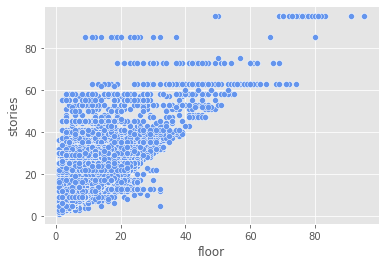

In [45]:
sns.scatterplot(x=df_train.loc[:,'floor'], y=df_train.loc[:,'stories'], color="#6495ED")

From this plot it is obvious that errors happened when importing the data - either storing the data or when the data was entered by users.

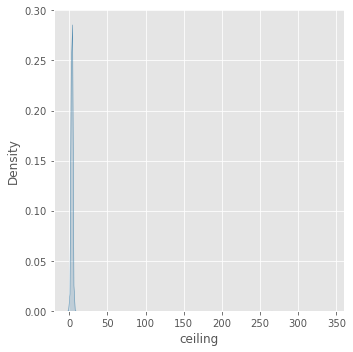

In [62]:
sns.displot(df_train, x=df_train['ceiling'], kind="kde", fill=True)

We again see that the ceiling distribution seems quite off. Let's look at some properties of this feature.

In [69]:
print("mean:   ", df_train['ceiling'].mean())
print("median: ", df_train['ceiling'].median())
print("max:    ", df_train['ceiling'].max())
print("min:    ", df_train['ceiling'].min())
print()
print("25%:    ", np.quantile(df_train['ceiling'],0.25))
print("75%:    ", np.quantile(df_train['ceiling'],0.75))
print()
print(" 5%:    ", np.quantile(df_train['ceiling'],0.05))
print("95%:    ", np.quantile(df_train['ceiling'],0.95))

mean:    3.268373523621374
median:  3.2683735236219706
max:     340.0
min:     0.0

25%:     2.75
75%:     3.2683735236219706

 5%:     2.64
95%:     3.2683735236219706


We see that at least 90% of the data has reasonable value but that there are some outliers that extremely skew the graph. We have thus decided to perform outlier removal for this feature.

<AxesSubplot:xlabel='area_total', ylabel='rooms'>

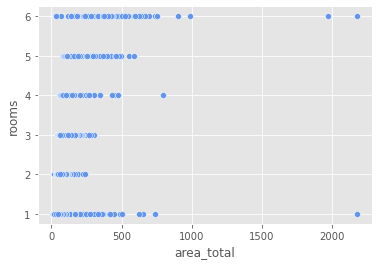

In [43]:
sns.scatterplot(x=df_train.loc[:,'area_total'], y=df_train.loc[:,'rooms'], color="#6495ED")

##### Categorical Features
Also interesting is how the price behaves compared to the categorical values.

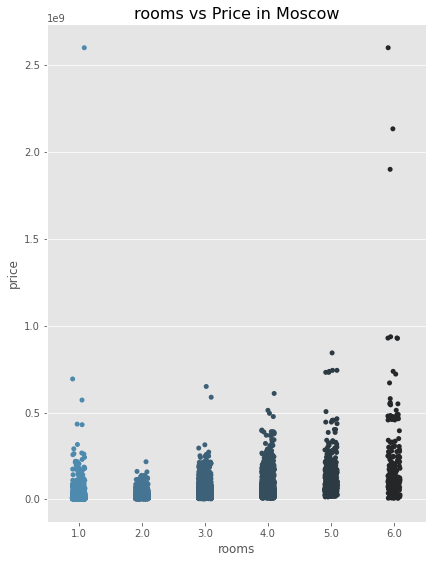

In [101]:
def cat_plot(data,xlabel,p):
    sns.catplot(x=xlabel, y="price", data=data,palette = p)
    plt.title(xlabel + ' vs Price in Moscow',size=16)
    plt.gcf().set_size_inches(6,8)
    plt.show()
    
custom_colors = ["#4e89ae", "#c56183","#ed6663","#ffa372"]
customPalette = sns.set_palette(sns.color_palette(custom_colors))
moscow = sns.dark_palette(custom_colors[0], reverse=True)
cat_plot(df_train,'rooms',moscow)

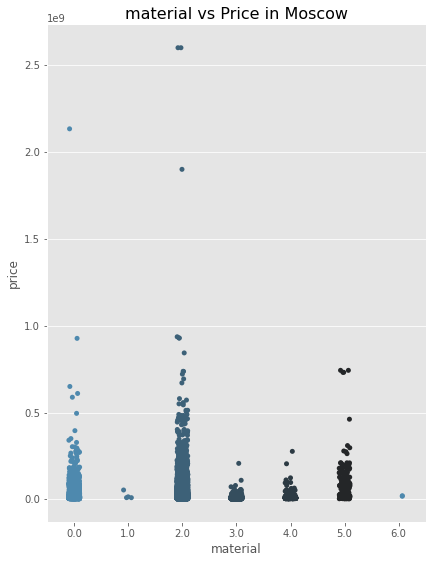

In [102]:
cat_plot(df_train,'material',moscow)
materials_legend = {0:"Bricks", 1:"Wood", 2:"Monolith", 3:"Panel", 4:"Block", 5:"Monolithic_brick", 6:"Stalin_project"}

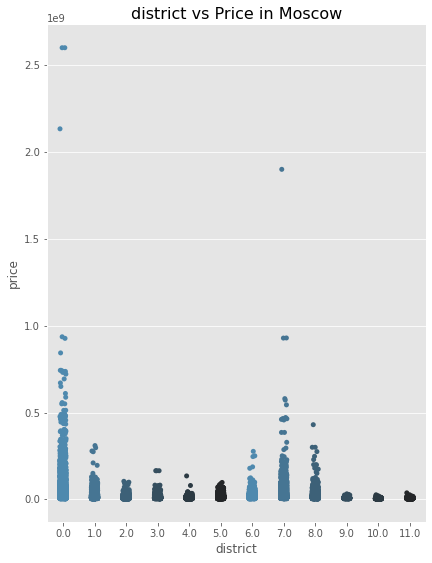

In [103]:
cat_plot(df_train,'district',moscow)
materials_legend = {0:"Central", 1:"North", 2:"North-East", 3:"East", 4:"South-East", 5:"South", 6:"South-West", 7:"West", 8:"North-West", 9:"Zelenograd", 10:"Troitsk", 11:"Novomoskovsk"}

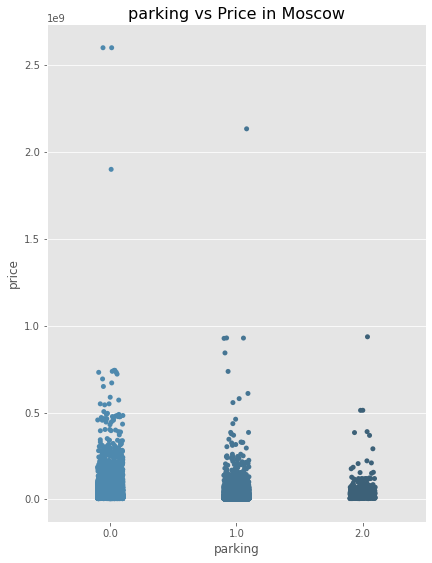

In [104]:
cat_plot(df_train,'parking',moscow)
materials_legend = {0:"Ground", 1:"Underground", 2:"Multilevel"}

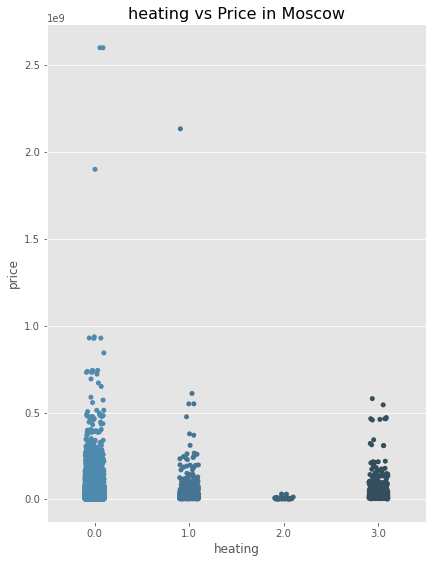

In [106]:
cat_plot(df_train,'heating',moscow)
materials_legend = {0:"Central", 1:"Individual", 2:"Boiler", 3:"Autonomous_boiler"}

We can further check if there is a big difference in new and old properties per district. It seems that most districts offer (much) more old than new appartments, except for district 11.

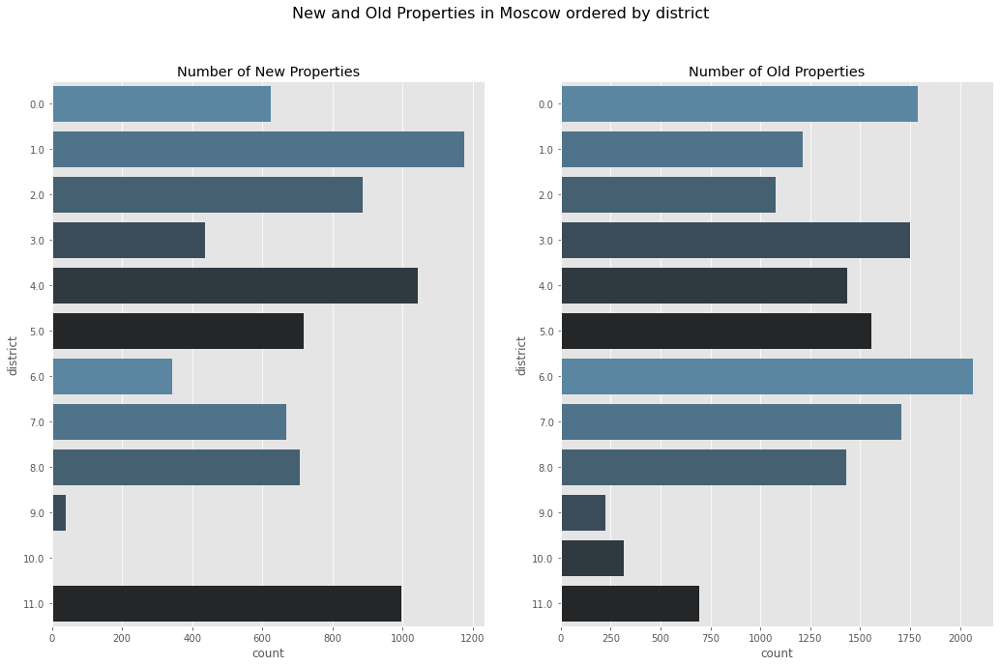

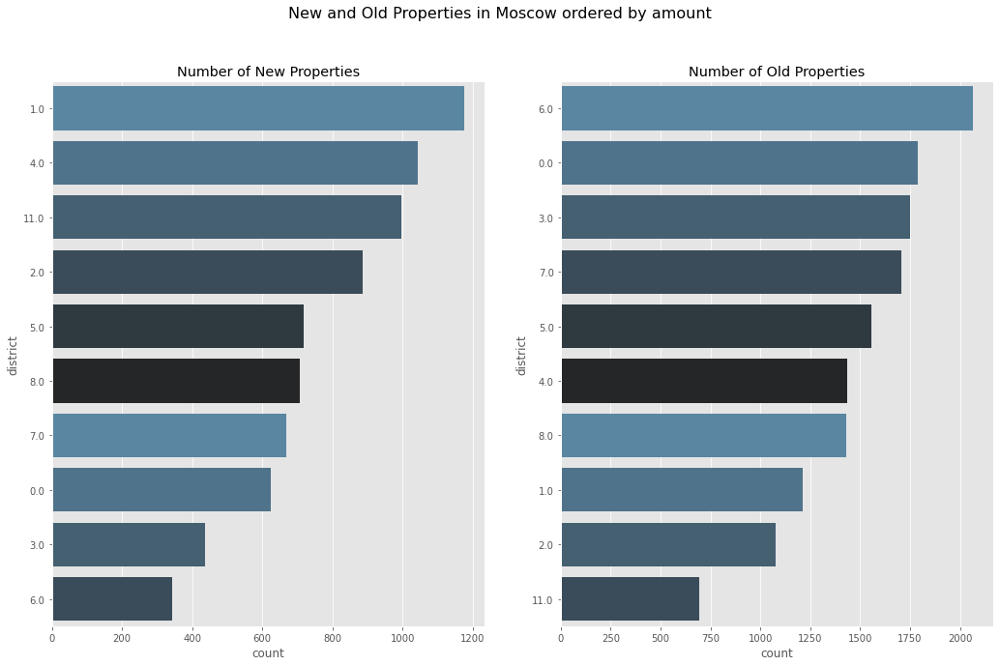

In [138]:
def count_plot(data,title,p):
    df5=data[data['new']== 1]
    df6=data[data['new']== 0]
    fig, ax = plt.subplots(1,2,figsize=(15, 10))
    ax[0]=sns.countplot(y='district', data=df5, ax=ax[0],palette = p)
    ax[0].set_title('Number of New Properties')
    ax[1]=sns.countplot(y='district', data=df6, ax=ax[1],palette = p)
    ax[1].set_title('Number of Old Properties')   
    
    fig.suptitle(title, fontsize=16)
    plt.tight_layout(pad=3.0)
    plt.show()
    
def count_plot_ordered(data,title,p):
    df5=data[data['new']== 1]
    df6=data[data['new']== 0]
    fig, ax = plt.subplots(1,2,figsize=(15, 10))
    ax[0]=sns.countplot(y='district', data=df5, order=df5.district.value_counts().index[:10], ax=ax[0],palette = p)
    ax[0].set_title('Number of New Properties')
    ax[1]=sns.countplot(y='district', data=df6, order=df6.district.value_counts().index[:10], ax=ax[1],palette = p)
    ax[1].set_title('Number of Old Properties')   
    
    fig.suptitle(title, fontsize=16)
    plt.tight_layout(pad=3.0)
    plt.show()
    
count_plot(df_train,'New and Old Properties in Moscow ordered by district',moscow)
count_plot_ordered(df_train,'New and Old Properties in Moscow ordered by amount',moscow)

TODO: extra on intuitivity? Maybe something about how new should relate to construction year

In [ ]:
####################################################################################################################################################################

# --------------------------- YOU ARE NOW BACK TO HENRIK EDA ---------------------------
## ------------------------------------------- Thank you, come again -------------------------------------------

### Missing values
In the cleaning process seen above, we already removed nans from some features, but we need to handle all nans before training on models. (some models can actually handle nans themselves, but most cannot).

Training set features with any missing value: 19/34
Testing set features with any missing value: 19/33
Features with no missing values: ['apartment_id', 'seller', 'price', 'area_total', 'area_kitchen', 'area_living', 'floor', 'rooms', 'building_id', 'latitude', 'longitude', 'district', 'street', 'address', 'stories']


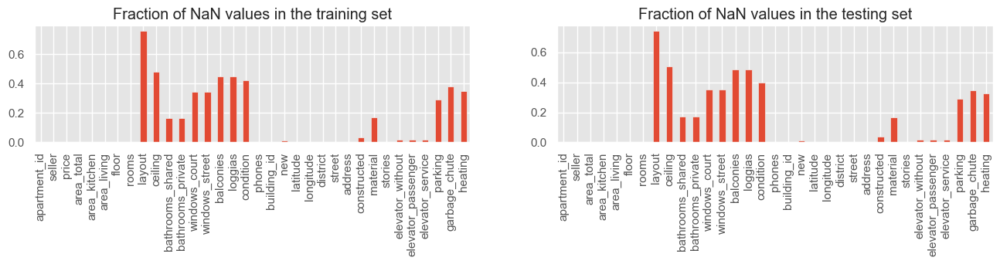

In [291]:
fig, (ax1, ax2) = plt.subplots(figsize=(16, 2), ncols=2, dpi=100)
print(f'Training set features with any missing value: {df_train.isna().any().sum()}/{df_train.shape[1]}')
print(f'Testing set features with any missing value: {df_test.isna().any().sum()}/{df_test.shape[1]}')
df_train.isna().mean().plot.bar(ax=ax1, title='Fraction of NaN values in the training set')
df_test.isna().mean().plot.bar(ax=ax2, title='Fraction of NaN values in the testing set');

featuresNA = dict(df_train.isna().any())
featuresNoNA = []
for key in featuresNA.keys():
    if not featuresNA[key] : featuresNoNA.append(key)
print('Features with no missing values:', featuresNoNA)

#### Other missing values

We still have a lot of columns with missing values in them. For the rest of the missing values, we decided to use the mean to fill the float numerical features and to use the median for all the other types of features. 

In [294]:
float_numerical_features = ["area_total", "area_kitchen", "area_living", "ceiling", "latitude", "longitude", "constructed"] # Float values.
int_numerical_features = ["floor", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies", "loggias", "phones"] # Ordinal categories/integers
cat_features = ["layout", "condition", "district", "material", "parking", "heating"] # All are non-ordinal categorical data

# Float
df_train[float_numerical_features] = df_train[float_numerical_features].fillna(df_train[float_numerical_features].mean())
df_test[float_numerical_features] = df_test[float_numerical_features].fillna(df_test[float_numerical_features].mean())
# Int
df_train[int_numerical_features] = df_train[int_numerical_features].fillna(df_train[int_numerical_features].median())
df_test[int_numerical_features] = df_test[int_numerical_features].fillna(df_test[int_numerical_features].median())
# Cat
df_train[cat_features] = df_train[cat_features].fillna(df_train[cat_features].median())
df_test[cat_features] = df_test[cat_features].fillna(df_test[cat_features].median())
# Bool (The rest)
df_train = df_train.fillna(df_train.median()) 
df_test = df_train.fillna(df_test.median()) 

C:\Users\henri\AppData\Local\Temp/ipykernel_1588/2854140237.py:15: FutureWarning:

Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.

C:\Users\henri\AppData\Local\Temp/ipykernel_1588/2854140237.py:16: FutureWarning:

Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.



Training set features with any missing value: 0/34
Testing set features with any missing value: 0/34
Features with no missing values: ['apartment_id', 'seller', 'price', 'area_total', 'area_kitchen', 'area_living', 'floor', 'rooms', 'layout', 'ceiling', 'bathrooms_shared', 'bathrooms_private', 'windows_court', 'windows_street', 'balconies', 'loggias', 'condition', 'phones', 'building_id', 'new', 'latitude', 'longitude', 'district', 'street', 'address', 'constructed', 'material', 'stories', 'elevator_without', 'elevator_passenger', 'elevator_service', 'parking', 'garbage_chute', 'heating']


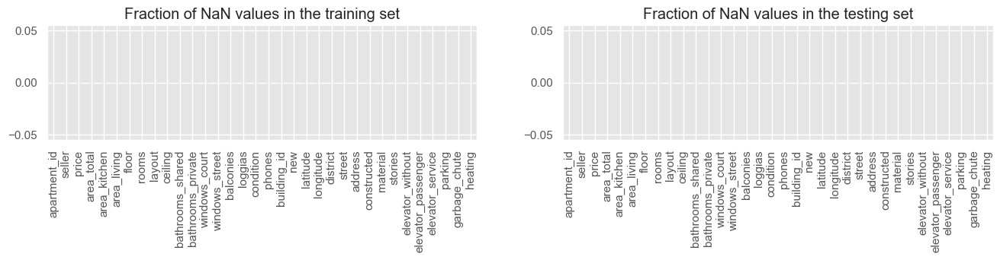

In [295]:
fig, (ax1, ax2) = plt.subplots(figsize=(16, 2), ncols=2, dpi=100)
print(f'Training set features with any missing value: {df_train.isna().any().sum()}/{df_train.shape[1]}')
print(f'Testing set features with any missing value: {df_test.isna().any().sum()}/{df_test.shape[1]}')
df_train.isna().mean().plot.bar(ax=ax1, title='Fraction of NaN values in the training set')
df_test.isna().mean().plot.bar(ax=ax2, title='Fraction of NaN values in the testing set');

featuresNA = dict(df_train.isna().any())
featuresNoNA = []
for key in featuresNA.keys():
    if not featuresNA[key] : featuresNoNA.append(key)
print('Features with no missing values:', featuresNoNA)

## Feature engineering
Now the basic cleaning and exploration is over. It is time to engineer our own data, and to introduce external data that might help.

#### Exploring Feature Correlation

Since feature correlation is a simple way of discovering linear relationships between the features themselves and the features and the target, checking the correlations is both a simple and important step in analyzing the data. Immediately is that some values are heavily correlated. It is important to be aware of this, since correlated features sometimes prevent models from learning their relationship with the target.

Text(0.5, 1.0, 'Correlations all data')

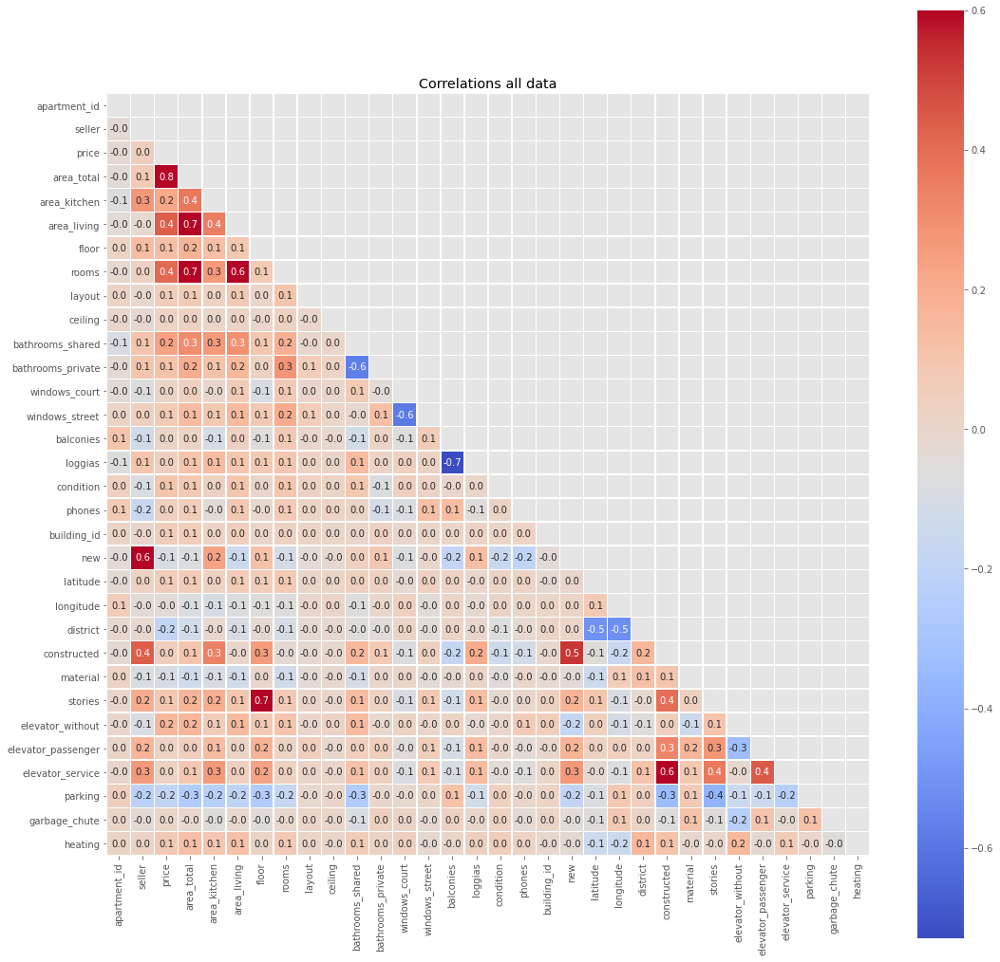

In [15]:
corr = df_train.corr()
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True

f,ax = plt.subplots(figsize=(18, 18))
sns.heatmap(df_train.corr(), mask=mask, vmax=0.6, square=True, cmap='coolwarm', annot=True, linewidths=.5, fmt= '.1f',ax=ax)
plt.title('Correlations all data')

Text(0.5, 1.0, 'Feature Correlation with price')

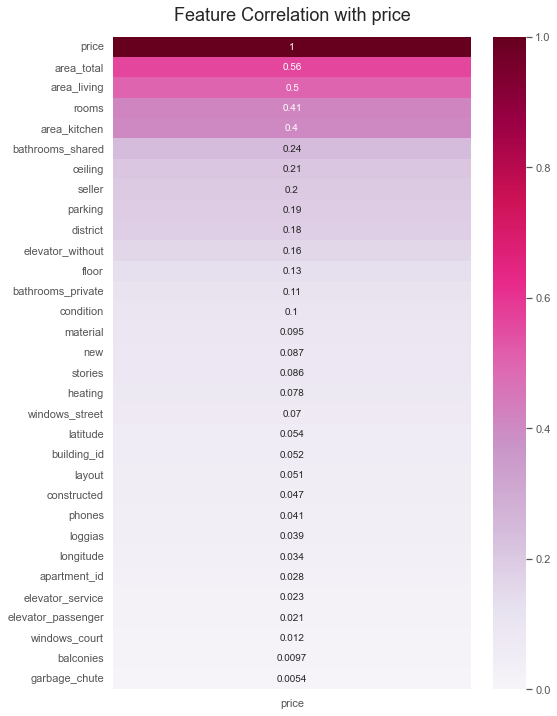

In [299]:
plt.figure(figsize=(8, 12))
heatmap = sns.heatmap(abs(df_train.corr()[['price']]).sort_values(by='price', ascending=False), vmin=0, vmax=1, annot=True, cmap='PuRd')
heatmap.set_title('Feature Correlation with price', fontdict={'fontsize':18}, pad=16)

**Initial thoughts about the feature importance**

The features `area_total` and `rooms` had no missing values in them and correlate strongly with the price. These will thus be some the main features. (`area_living` and `area_kitchen` are very correlated to `area_total` so they may not be very useful). These features can however become very dominating in the training, limiting how accurate our models can become, by being too reliant on these features. 

A possible workaround is to train the model on predicting price/area instead of price directly, and dropping area_total from training data.

### Helper functions
Before moving on, we will define some helper functions to both load and clean the data, so we can easily get the results shown above.

In [316]:
def load_all_data(fraction_of_data=1, apartment_id='apartment_id',path=None):
    
    if path is not None:
        # Metadata
        metaData_apartment = pd.read_json(path+'./data/apartments_meta.json')
        metaData_building = pd.read_json(path+'./data/buildings_meta.json')
        metaData = pd.concat([metaData_apartment, metaData_building])

        # Train
        train_apartment = pd.read_csv(path+'./data/apartments_train.csv')
        train_building = pd.read_csv(path+'./data/buildings_train.csv')

        # Test
        test_apartment = pd.read_csv(path+'./data/apartments_test.csv')
        test_building = pd.read_csv(path+'./data/buildings_test.csv')
    
    else:
    # Metadata
        metaData_apartment = pd.read_json('./data/apartments_meta.json')
        metaData_building = pd.read_json('./data/buildings_meta.json')
        metaData = pd.concat([metaData_apartment, metaData_building])

        # Train
        train_apartment = pd.read_csv('./data/apartments_train.csv')
        train_building = pd.read_csv('./data/buildings_train.csv')

        # Test
        test_apartment = pd.read_csv('./data/apartments_test.csv')
        test_building = pd.read_csv('./data/buildings_test.csv')
  
    train = pd.merge(train_apartment, train_building, left_on='building_id', right_on='id')
    train.rename(columns={'id_x' : apartment_id}, inplace=True)
    train.drop('id_y', axis=1, inplace=True)
    train = train.head(int(train.shape[0] * fraction_of_data))


    test = pd.merge(test_apartment, test_building, left_on='building_id', right_on='id')
    test.rename(columns={'id_x' : apartment_id}, inplace=True)
    test.drop('id_y', axis=1, inplace=True)

    return train, test, metaData

In [317]:
def clean_data(train, test,
                 features, float_numerical_features, int_numerical_features, cat_features,
                 log_targets=True, log_area=True, fillNan=True, log1_area=False, log1_targets=False):
    '''Clean the data according to best knowledge so far...
   
    '''



    # Extract
    train_labels = train[features]
    test_labels = test[features]
    train_targets = train['price']

    # Log targets
    if log_targets:
        train_targets = np.log(train_targets)
    elif log1_targets:
        print("log1p targets!")
        train_targets = np.log1p(train_targets)

    ## ------------------------------------------------------------------------------------------------ ##
    # TODO: Shoul we use thise at all?
    # Fill nans using correlated features
    train_labels = fillnaReg(train_labels, ['area_total'], 'area_living')
    test_labels = fillnaReg(test_labels, ['area_total'], 'area_living')
    # Area_kitchen
    train_labels = fillnaReg(train_labels, ['area_total', 'area_living'], 'area_kitchen')
    test_labels = fillnaReg(test_labels, ['area_total', 'area_living'], 'area_kitchen')
    # ceiling
    is_outlier = ((train_labels["ceiling"] > 10) | (train_labels["ceiling"] < 0.5))
    outliers = train_labels.copy()[is_outlier]
    inliers_index=[]
    for index in train_labels.index:
        if index not in outliers.index:
            inliers_index.append(index)
    train_labels.loc[outliers.index,['ceiling']] = train_labels.loc[inliers_index,['ceiling']].mean()

    is_outlier = ((test_labels["ceiling"] > 10) | (test_labels["ceiling"] < 0.5))
    outliers = test_labels.copy()[is_outlier]
    for index in test_labels.index:
        if index not in outliers.index:
            inliers_index.append(index)
    test_labels.loc[outliers.index,['ceiling']] = test_labels.loc[test_labels.index.intersection(inliers_index),['ceiling']].mean()

    ## ------------------------------------------------------------------------------------------------ ##

    # Remove zero area living
    # TODO: why not > 0?
    remove_zero = [row["area_living"] if row["area_living"] >= 1 else row["area_total"]*(train_labels["area_living"].mean() / train_labels["area_total"].mean()) for _, row in train_labels.iterrows()] 
    train_labels["area_living"] = remove_zero

    remove_zero = [row["area_living"] if row["area_living"] >= 1 else row["area_total"]*(test_labels["area_living"].mean() / test_labels["area_total"].mean()) for _, row in test_labels.iterrows()] 
    test_labels["area_living"] = remove_zero

    # Log the areas
    fs = ["area_total", "area_living", "area_kitchen"]
    if log_area:
        for feature in fs:
            # Logging
            train_labels[feature] = np.log(train_labels[feature])
            test_labels[feature] = np.log(test_labels[feature])
    elif log1_area:
        print("log1p area!!")
        for feature in fs:
            # Logging
            train_labels[feature] = np.log1p(train_labels[feature])
            test_labels[feature] = np.log1p(test_labels[feature])


    # remove upper Strip
    remove_upper_stripe = [row["area_living"] if row["area_living"] < row["area_total"] else row["area_total"]*(train_labels["area_living"].mean() / train_labels["area_total"].mean()) for _, row in train_labels.iterrows()] 
    train_labels["area_living"] = remove_upper_stripe

    remove_upper_stripe = [row["area_living"] if row["area_living"] < row["area_total"] else row["area_total"]*(test_labels["area_living"].mean() / test_labels["area_total"].mean()) for _, row in test_labels.iterrows()] 
    test_labels["area_living"] = remove_upper_stripe
    ## ------------------------------------------------------------------------------------------------ ##


    # Fillnans of the two lat/log.
    # Insert median district
    #unknown_index = test_labels[["district", "latitude", "longitude"]][test_labels["latitude"].isna()==True].index
    #test_labels.loc[unknown_index,['district']] = test_labels["district"].median()
    ## Mean the long/lat
    #test_labels["longitude"] = test_labels["longitude"].fillna(test_labels["longitude"].mean())
    #test_labels["latitude"] = test_labels["latitude"].fillna(test_labels["latitude"].mean())

    # Both nans in test-data is in same known street.
    # (37.470959, 55.570540)
    is_na = (test_labels["longitude"].isna())
    nas = test_labels.copy()[is_na]
    test_labels.loc[nas.index,['longitude']] = 37.470959
    test_labels.loc[nas.index,['latitude']] = 55.570540
    

    # Fix houses on the "north pole".
    is_outlier = (test_labels["longitude"] > 39) | (test_labels["longitude"] < 35)
    outliers = test_labels.copy()[is_outlier]
    for index in outliers.index:
        if test_labels.loc[index,['street']][0]=="Бунинские Луга ЖК":
            test_labels.loc[index,['longitude']] = 37.482297
            test_labels.loc[index,['latitude']] = 55.543673
        elif test_labels.loc[index,['street']][0]=="улица Центральная":
            test_labels.loc[index,['longitude']] = 37.640383
            test_labels.loc[index,['latitude']] = 55.566131
        else:
            test_labels.loc[index,['longitude']] = train_labels["longitude"].mean()
            test_labels.loc[index,['latitude']] = train_labels["latitude"].mean()
            test_labels.loc[index,['street']] = "Ленинский проспект"

    
    # Fill districts using long/lat
    district_centre_long = np.array(train_labels[["district", "longitude"]].groupby(['district']).mean())
    district_centre_lat = np.array(train_labels[["district", "latitude"]].groupby(['district']).mean())
    remove_nan_districts = [closest_district(row["latitude"],
     row["longitude"], district_centre_long, district_centre_lat) if math.isnan(row["district"]) else row["district"] for _, row in train_labels.iterrows()] 
    train_labels["district"] = remove_nan_districts
    remove_nan_districts = [closest_district(row["latitude"],
     row["longitude"], district_centre_long, district_centre_lat) if math.isnan(row["district"]) else row["district"] for _, row in test_labels.iterrows()] 
    test_labels["district"] = remove_nan_districts

    # Fix the seller with unknown category
    unknown_category = len(list(train_labels["seller"].unique())) - 1
    train_labels["seller"] = train_labels["seller"].fillna(unknown_category)
    test_labels["seller"] = test_labels["seller"].fillna(unknown_category)
    ## --------------------------------------------------------------------------------------------------------------- ##
    if fillNan:
        # Taking care of the string features first... NB! no nans in string data.
        # Fill rest with median or mean
        # Float
        train_labels[float_numerical_features] = train_labels[float_numerical_features].fillna(train_labels[float_numerical_features].mean())
        # Int
        train_labels[int_numerical_features] = train_labels[int_numerical_features].fillna(train_labels[int_numerical_features].median())
        # Cat
        train_labels[cat_features] = train_labels[cat_features].fillna(train_labels[cat_features].median())
        # Bool (The rest)
        train_labels = train_labels.fillna(train_labels.median()) # Boolean

        # Float
        test_labels[float_numerical_features] = test_labels[float_numerical_features].fillna(test_labels[float_numerical_features].mean())
        # Int
        test_labels[int_numerical_features] = test_labels[int_numerical_features].fillna(test_labels[int_numerical_features].median())
        # Cat
        test_labels[cat_features] = test_labels[cat_features].fillna(test_labels[cat_features].median())
        # Bool (The rest)
        test_labels = test_labels.fillna(test_labels.median()) # Boolean

    if "constructed" in features:
        # Is supposed to be integer.
        train["constructed"] = np.asarray(train["constructed"]).astype("int")
        test["constructed"] = np.asarray(test["constructed"]).astype("int")

    return train_labels, train_targets, test_labels

In [318]:
# All features
features =           ["building_id", # For grouping, later on
                      "area_total", "area_kitchen", "area_living", "floor", "ceiling", "stories", "rooms",
                      "bathrooms_private", "bathrooms_shared", "balconies","loggias", "phones", "latitude", "longitude", "constructed", # Numerical
                     "layout", "condition", "district", "material", "parking", "heating", "seller", #Categorical
                      "windows_court", "windows_street", "new", "elevator_without", "elevator_passenger", "elevator_service", "garbage_chute", # Bool
                     "street", "address"] # Strings

all_numerical_features = ["area_total", "area_kitchen", "area_living", "floor",
                      "ceiling", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies","loggias", "phones", "latitude", "longitude", "constructed"]

float_numerical_features = ["area_total", "area_kitchen", "area_living", "ceiling", "latitude", "longitude", "constructed"]

int_numerical_features = ["floor", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies", "loggias", "phones"] # Ordinal categories

cat_features = ["layout", "condition", "district", "material", "parking", "heating", "seller"] # All are non-ordinal

droptable = []

# Load data
train, test, metaData = load_all_data()
# Clean data
train_labels, train_targets, test_labels = clean_data(train, test, features, float_numerical_features, int_numerical_features, cat_features,
                                                      log_targets=True, log_area=True, fillNan=True)

C:\Users\henri\AppData\Local\Temp/ipykernel_1588/2629155559.py:137: FutureWarning:

Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.

C:\Users\henri\AppData\Local\Temp/ipykernel_1588/2629155559.py:146: FutureWarning:

Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.



#### R and Theta

Since the city of Moscow is contains a city center and the most expensive apartments are close to this center, we though it would be more representative to use r and theta (radius and angle) for the apartment position instead of latitude and longitude. We also moved the origin of latitude and longitude to the mean.  

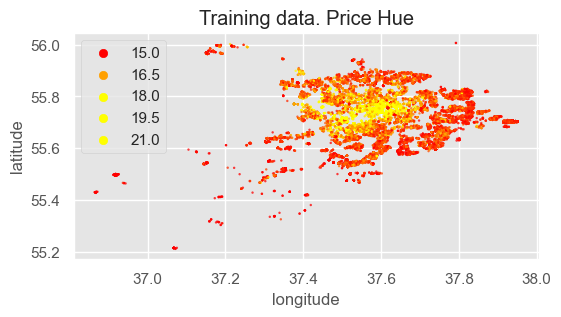

In [322]:
fig, ax1 = plt.subplots(figsize=(6, 3), dpi=100)
lo, hi = train_targets.quantile([0.1, 0.8])
hue_norm = plt.Normalize(lo, hi)
hue = train_targets.tolist()

ax1.set_title("Training data. Price Hue")
sns.scatterplot(x='longitude', y='latitude', ax=ax1, hue=hue, alpha=0.75, s=3, palette="autumn", linewidth=0, hue_norm=hue_norm, data=train_labels[['latitude', 'longitude']]);

In [323]:
#########################################################################################
# Get placeholders, so we dont ruin the original data.
labels1_normed_r = train_labels[["latitude", "longitude"]].copy()
test1_normed_r = test_labels[["latitude", "longitude"]].copy()
#########################################################################################
## Move origo to center of city.
train_float_mean = df_train["longitude"].mean()
test_float_mean = df_test["longitude"].mean()
tl = len(df_train) + len(df_test)
total_mean_long = (train_float_mean*len(df_train) + test_float_mean*len(df_test)) / tl
##
train_float_mean = df_train["latitude"].mean()
test_float_mean = df_test["latitude"].mean()
tl = len(df_train) + len(df_test)
total_mean_lat = (train_float_mean*len(df_train) + test_float_mean*len(df_test)) / tl 
##
labels1_normed_r['latitude'] = labels1_normed_r['latitude'] - total_mean_lat
labels1_normed_r['longitude'] = labels1_normed_r['longitude'] - total_mean_long
test1_normed_r['latitude'] = test1_normed_r['latitude'] -  total_mean_lat
test1_normed_r['longitude'] = test1_normed_r['longitude'] -  total_mean_long
## Convert to polar coordinates
labels1_normed_r['r'] =  np.sqrt(labels1_normed_r['latitude']**2 + labels1_normed_r['longitude']**2)
labels1_normed_r['theta'] = np.arctan(labels1_normed_r['longitude']/labels1_normed_r['latitude'])
test1_normed_r['r'] =  np.sqrt(test1_normed_r['latitude']**2 + test1_normed_r['longitude']**2)
test1_normed_r['theta'] = np.arctan(test1_normed_r['longitude']/test1_normed_r['latitude'])
#########################################################################################
# Add the polar coordinates.
train_labels["r"] = labels1_normed_r['r']
train_labels["theta"] = labels1_normed_r['theta']
test_labels["r"] = test1_normed_r['r']
test_labels["theta"] = test1_normed_r['theta']

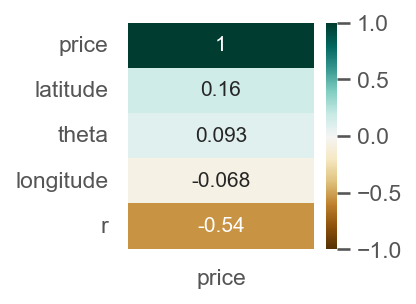

In [324]:
f, ax = plt.subplots(figsize=(2, 2), dpi=150)
heatmap = sns.heatmap(pd.merge(train_labels[["r", "theta", "longitude", "latitude"]],
                               train_targets, left_index=True, right_index=True).corr()[["price"]].sort_values(by="price", ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG', ax=ax)

**The `r`** features is really interesting, with a good correlation, as we could have guessed. The `theta` however doesnt seem that interesting. 

#### Distance to metro
From wikipedia you can get a nice list of all subways stops in Moscow:
https://en.wikipedia.org/wiki/List_of_Moscow_Metro_stations

In [327]:
# The stations of moscow
stations = pd.read_excel("metro_stations.xlsx")
longs = np.zeros(len(stations))
lats = np.zeros(len(stations))
for i, row in stations.iterrows():
    l = str(row["Coordinates"]).split(",")
    longs[i] = l[0]
    lats[i] = l[1]
    
stations["longitude"] = longs
stations["latitude"] = lats
stations.head(3)

,Name,Coordinates,longitude,latitude
0,Bulvar Rokossovskogo (Sokolnicheskaya line),"37.7342,55.8148,0",37.7342,55.8148
1,Cherkizovskaya,"37.7448,55.8038,0",37.7448,55.8038
2,Preobrazhenskaya Ploshchad,"37.7151,55.7963,0",37.7151,55.7963


**Location** on the stations on a map

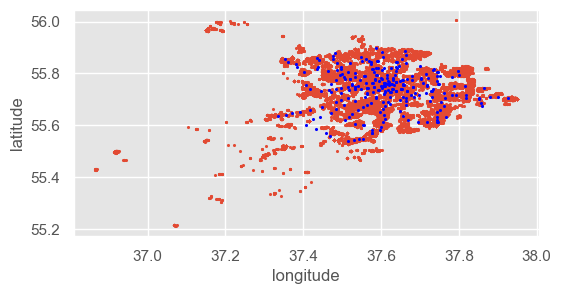

In [336]:
fig, ax1 = plt.subplots(figsize=(6, 3), dpi=100)
sns.scatterplot(x='longitude', y='latitude', ax=ax1, alpha=1, s=5,
                linewidth=0, 
                hue_norm=hue_norm,
                data=train_labels[['longitude', 'latitude']])

sns.scatterplot(x='longitude', y='latitude', color="blue", ax=ax1, s=5, linewidth=0, data=stations[['longitude', 'latitude']])
plt.show()

**We will make two new features based on this:** 
- Lives in "walking" distance from a stop: is a bool
- Distance from nearest stop: a float value

In [338]:
def eucledian_distance(point1, point2):
    return np.sqrt((point1[0]-point2[0])**2 + (point1[1]-point2[1])**2)


Find distance to nearest metro station

In [ ]:
## Distance to nearest metro stations
dist_to_metro_train = np.zeros(len(train_labels))
for i, row_t in train_labels.iterrows():
    apartment = (row_t["longitude"], row_t["latitude"])
    nearest_dist = -1
    for j, row_s in stations.iterrows():
        station = (row_s["longitude"], row_s["latitude"]) 
        distance = eucledian_distance(station, apartment)
        if distance < nearest_dist or nearest_dist==-1:
            nearest_dist=distance
    
    dist_to_metro_train[i] = nearest_dist
## Distance to nearest metro stations
dist_to_metro_test = np.zeros(len(test_labels))
for i, row_t in test_labels.iterrows():
    apartment = (row_t["longitude"], row_t["latitude"])
    nearest_dist = -1
    for j, row_s in stations.iterrows():
        station = (row_s["longitude"], row_s["latitude"]) 
        distance = eucledian_distance(station, apartment)
        if distance < nearest_dist or nearest_dist==-1:
            nearest_dist=distance

    dist_to_metro_test[i] = nearest_dist

np.savetxt("metro_distances_train.csv", dist_to_metro_train)
np.savetxt("metro_distances_test.csv", dist_to_metro_test)

Translate the long/lat distance to meters, and add the feature

In [347]:
dist_to_metro_train = np.loadtxt("metro_distances_train.csv")
dist_to_metro_test = np.loadtxt("metro_distances_test.csv")

In [348]:
train_labels["dist_to_metro"] = dist_to_metro_train
train_labels["dist_to_metro_in_meters"] = train_labels["dist_to_metro"] * (2*np.pi*(6371000) / 360)
train_labels["metro_walking_distance"] = train_labels["dist_to_metro"]<train_labels["dist_to_metro"].median()

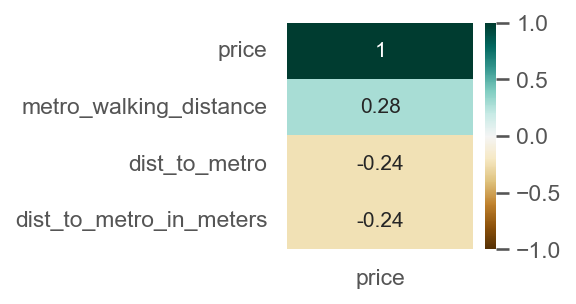

In [350]:
f, ax = plt.subplots(figsize=(2, 2), dpi=150)
heatmap = sns.heatmap(pd.merge(train_labels[["dist_to_metro", "dist_to_metro_in_meters", "metro_walking_distance"]],
                               train_targets, left_index=True, right_index=True).corr()[["price"]].sort_values(by="price", ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG', ax=ax)

Living close to the metro stops, is as we can see from the map, pretty correlated to living in the center of the city. We already have the feature `r` showing us that buying close to the center is more expensive - so the negative correlation here makes a lot of sense.

#### Floor data - what floor is the best to live on? 

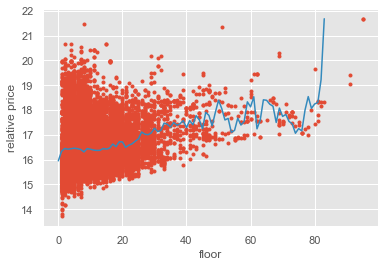

In [353]:
df_all = pd.merge(train_labels[["floor"]], train_targets, left_index=True, right_index=True)
floor_mean = df_all.groupby("floor")["price"].mean()
plt.plot(train_labels["floor"].values, train_targets.values, ".")
plt.plot(range(len(floor_mean)), floor_mean, "-")
plt.xlabel("floor")
plt.ylabel("relative price")
plt.show()

It seems that the general trend is that living higher up is more expensive. Also, we see a clear dip in the data on the first floor -which makes a lot of sense, as living in the first floor of an apartment building is usually not sought after.

In [357]:
# FLOOR
train_labels['rel_height'] = np.asarray(train_labels["floor"] / train_labels["stories"]).astype("float32")

train_labels["lives_in_highrise"] = np.asarray((train_labels["stories"]>30)).astype("int")

train_labels["first_floor"] = np.asarray(train_labels["floor"]==1).astype("int")

train_labels["floor_inverse"] = train_labels["stories"]-train_labels["floor"]
median_floor_inverse = np.median(train_labels["floor_inverse"])
train_labels["floor_inverse_median"]=train_labels["floor_inverse"].where(train_labels["floor_inverse"]>=0, other=median_floor_inverse)

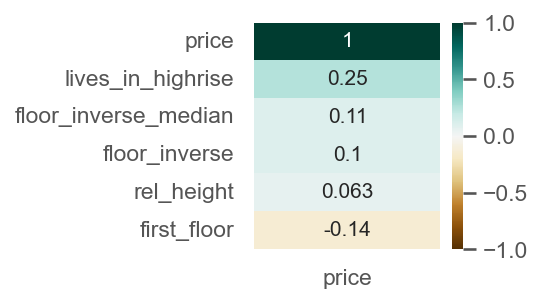

In [358]:
f, ax = plt.subplots(figsize=(2, 2), dpi=150)
heatmap = sns.heatmap(pd.merge(train_labels[["rel_height", "lives_in_highrise", "first_floor", "floor_inverse", "floor_inverse_median"]],
                               train_targets, left_index=True, right_index=True).corr()[["price"]].sort_values(by="price", ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG', ax=ax)

### Street names - how good is your russian?

Looking through the streetnames we found some (using google translate) some interesting street names.

In [366]:
name_dict = {
    "highway" : "шоссе", #33
    "street" : "улица", # 1038
    "park" : "Парк", # 24
    "avenue" : "проспект", # 36
    "meadows" : "Луга", # 3
    "microdistrict" : "мкр", # 31
    "seafront" : "набережная", # 32
    "thoroughfare" : "проезд", # 160
    "boulevard" : "бульвар", # 54
    "alley" : "аллея", # 8
}

In [367]:
added_features=[]
for _, key in enumerate(name_dict.keys()):
    on_type = [1 if name_dict[key] in row["street"] else 0 for _, row in train_labels.iterrows()] 
    train_labels["on_"+key] = on_type
    added_features.append("on_"+key)

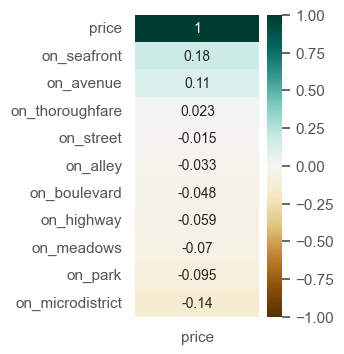

In [370]:
f, ax = plt.subplots(figsize=(2, 4), dpi=100)
heatmap = sns.heatmap(pd.merge(train_labels[added_features],
                               train_targets, left_index=True, right_index=True).corr()[["price"]].sort_values(by="price", ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG', ax=ax)

**So, out of all the types of streets, it was only the `seafront`/`набережная` and `avenue`/`проспект` really that was positive correlated to price.
On the other side we have the `park`/`Парк` and `microdistrict`/`мкр` that was not nice to live in.**

We can add these two as new features, while the others are not really that interesting to keep.

**We then plotted and found what was the best streets to live in in Moscow***: 

["Мосфильмовская улица", "набережная Пресненская", "улица Ефремова", "Казарменный переулок"] 

In [371]:
good_streets = ["Мосфильмовская улица", "набережная Пресненская", "улица Ефремова", "Казарменный переулок"] # From the analysis below.

In [372]:
added_feats = []
for street_name in good_streets:
    on_street = [1 if street_name in row["street"] else 0 for _, row in train_labels.iterrows()] 
    train_labels["in_"+street_name] = on_street
    added_feats.append("in_"+street_name)

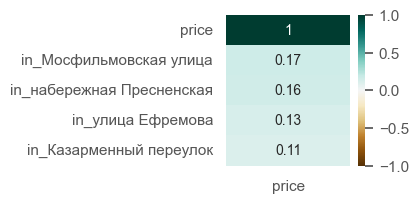

In [373]:
f, ax = plt.subplots(figsize=(2,2), dpi=100)
#[["price"]].sort_values(by="price", ascending=False)
heatmap = sns.heatmap(pd.merge(
    train_labels[added_feats],
    train_targets, left_index=True, right_index=True).corr()[["price"]].sort_values(by="price", ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG', ax=ax)

Using *GoogleStreetView* we see that these are indeed some nice areas, confirming our theory.

#### Age of building
Living in an old building is in most cases not sought after; larger electrical bill and more renovation. 
> Lets plot the mean selling price for each year of construction.

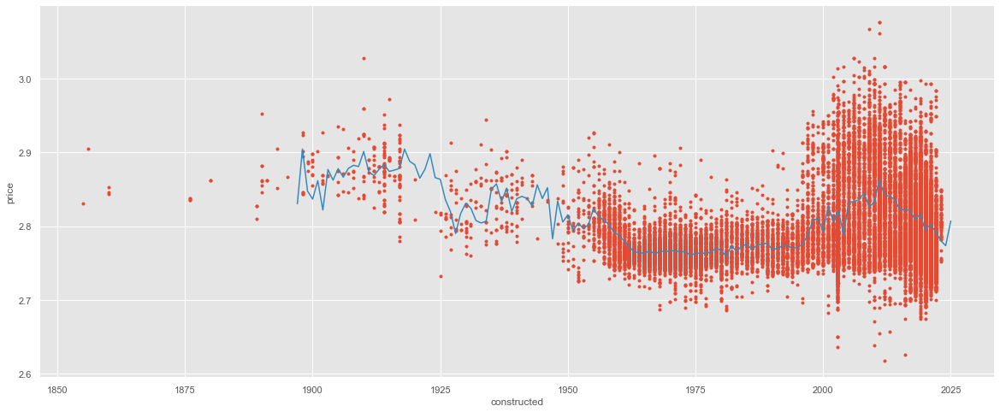

In [359]:
df_all = pd.merge(train_labels[["constructed"]], np.log(train_targets), left_index=True, right_index=True)
constructed_mean = df_all.groupby("constructed")["price"].mean()
plt.figure(figsize=(20, 8))
plt.plot(train_labels["constructed"].values, np.log(train_targets.values), ".")
plt.xlabel("constructed")
plt.ylabel("price")
plt.plot(range(1897, len(constructed_mean)+1897), constructed_mean, "-")
plt.show()

**Interesting!** Very old buildings are either already demolished or well kept it seems. The cold-war period was a period of economic regression in Russia (at least according to my western history theaching). We can see this reflected in the price from this area: pobably a lot of cheap, grey, boring apartment buildings (so-called "østblokk" in norwegian, meaning east-block / boring apartment building from the east (= From russia)). 

In [362]:
train_labels["age_building"] = 2021 - train_labels["constructed"]
train_labels["old_building"] = (train_labels["constructed"]<1950)
train_labels["cold_war_building"] = (train_labels["constructed"]>1955) & (train_labels["constructed"]<2000)
train_labels["modern_but_not_too_modern"] = (train_labels["constructed"]>200) & (train_labels["constructed"]<2018)

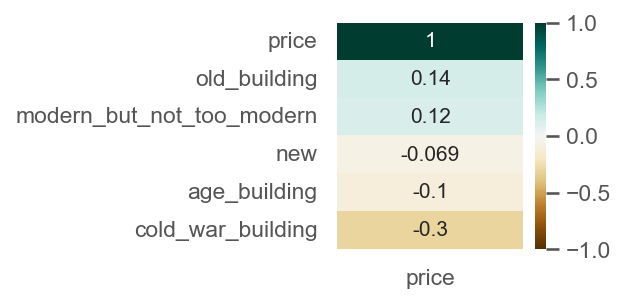

In [365]:
f, ax = plt.subplots(figsize=(2, 2), dpi=150)
heatmap = sns.heatmap(pd.merge(train_labels[["age_building", "old_building", "cold_war_building", "modern_but_not_too_modern", "new"]],
                               train_targets, left_index=True, right_index=True).corr()[["price"]].sort_values(by="price", ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG', ax=ax)

**NEW** is a feature of the dataset, lets look more into it.

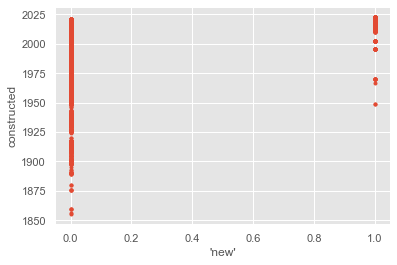

In [364]:
plt.plot(train_labels["new"], train_labels["constructed"], ".")
plt.xlabel("'new'")
plt.ylabel("constructed")
plt.show()

We can see that the "new" feature is not actually when the building was made, and might rather be about when the apartment was refurbished. What is surprising is how uncorrelated it is to price.

#### Some other features

In [ ]:
# Add "Spacious_rooms": area per room
train_labels['spacious_rooms'] = train_labels['area_total'] / train_labels['rooms']
test_labels['spacious_rooms'] = test_labels['area_total'] / test_labels['rooms']
added_features.append('spacious_rooms')

train_labels["rel_living"] = np.asarray(train_labels["area_living"] / train_labels["area_total"]).astype("float32")
test_labels["rel_living"] = np.asarray(test_labels["area_living"] / test_labels["area_total"]).astype("float32")
added_features.append("rel_living")

train_labels["total_bathrooms"] = np.asarray(train_labels["bathrooms_private"] + train_labels["bathrooms_shared"]).astype("int")
test_labels["total_bathrooms"] = np.asarray(test_labels["bathrooms_private"] + test_labels["bathrooms_shared"]).astype("int")
added_features.append("total_bathrooms")

# Some boolean features
train_labels["multiple_balconies"] = np.asarray((train_labels["balconies"]>1)).astype("int")
test_labels["multiple_balconies"] = np.asarray((test_labels["balconies"]>1)).astype("int")
added_features.append("multiple_balconies")

train_labels["multiple_loggias"] = np.asarray((train_labels["loggias"]>1)).astype("int")
test_labels["multiple_loggias"] = np.asarray((test_labels["loggias"]>1)).astype("int")
added_features.append("multiple_loggias")

train_labels["both_windows"] = np.asarray((train_labels["windows_court"]==True) & (train_labels["windows_street"]==True)).astype("int")
test_labels["both_windows"] = np.asarray((test_labels["windows_court"]==True) & (test_labels["windows_street"]==True)).astype("int")
added_features.append("both_windows")

# Relative kitchen space
train_labels["rel_kitchen"] = np.asarray(train_labels["area_kitchen"] / train_labels["area_total"]).astype("float32")
test_labels["rel_kitchen"] = np.asarray(test_labels["area_kitchen"] / test_labels["area_total"]).astype("float32")
added_features.append("rel_kitchen")

#Close to state university of moscow
uni_location = (37.5286, 55.7039)
## Distance to state university
dist_to_uni_train = np.zeros(len(train_labels))
for i, row_t in train_labels.iterrows():
    apartment = (row_t["longitude"], row_t["latitude"])
    dist_to_uni_train[i] = eucledian_distance(apartment, uni_location)
dist_to_uni_test = np.zeros(len(test_labels))
for i, row_t in test_labels.iterrows():
    apartment = (row_t["longitude"], row_t["latitude"])
    dist_to_uni_test[i] = eucledian_distance(apartment, uni_location)
# Meter edition
dist_to_uni_train_meters = dist_to_uni_train*(2*np.pi*(6371000) / 360)
dist_to_uni_test_meters = dist_to_uni_test*(2*np.pi*(6371000) / 360)
# Close to uni 
train_labels["close_to_uni"] = np.asarray((dist_to_uni_train_meters<2000)).astype("int")
test_labels["close_to_uni"] = np.asarray((dist_to_uni_test_meters<2000)).astype("int")
added_features.append('close_to_uni')

## close to state hospital
# Location of state hospital
hosp_location = (37.389167, 55.746389)
## Distance to state university
dist_to_hosp_train = np.zeros(len(train_labels))
for i, row_t in train_labels.iterrows():
    apartment = (row_t["longitude"], row_t["latitude"])
    dist_to_hosp_train[i] = eucledian_distance(apartment, hosp_location)
dist_to_hosp_test = np.zeros(len(test_labels))
for i, row_t in test_labels.iterrows():
    apartment = (row_t["longitude"], row_t["latitude"])
    dist_to_hosp_test[i] = eucledian_distance(apartment, hosp_location)

dist_to_hosp_train_meters = dist_to_hosp_train*(2*np.pi*(6371000) / 360)
train_labels["dist_to_hospital_m"] = dist_to_hosp_train_meters
dist_to_hosp_test_meters = dist_to_hosp_test*(2*np.pi*(6371000) / 360)
test_labels["dist_to_hospital_m"] = dist_to_hosp_test_meters
added_features.append('dist_to_hospital_m')

# A collection of more features
train_labels["area_floor"] = train_labels["area_total"] / train_labels["floor"]
train_labels["area_stories"] = train_labels["area_total"] / train_labels["stories"]
train_labels["area_rooms"] = train_labels["area_total"] / np.average(train_labels["rooms"]) # is just the invert of spacious rooms
train_labels["bathroom_area"] = (train_labels["bathrooms_private"] + train_labels["bathrooms_shared"])/train_labels["area_total"]
train_labels['bathrooms_per_room'] = (train_labels["total_bathrooms"])/train_labels["rooms"]

test_labels["area_floor"] = test_labels["area_total"] / test_labels["floor"]
test_labels["area_stories"] = test_labels["area_total"] / test_labels["stories"]
test_labels["area_rooms"] = test_labels["area_total"] / np.average(test_labels["rooms"]) # is just the invert of spacious rooms
test_labels["bathroom_area"] = (test_labels["bathrooms_private"] + test_labels["bathrooms_shared"])/test_labels["area_total"]
test_labels['bathrooms_per_room'] = (test_labels["total_bathrooms"])/test_labels["rooms"]




##### Areas versus averages
Since area is such an important feature, we made extra features based on the relation area has to different categories. We thus developed the following features:
* `area_average_rooms`: the average total area divided by the average number of rooms.
* `average_area_total_district`: the total area divided by the average total area for the district the apartment is located in.
* `average_area_living_district`: same as above but for living area.
* `average_area_kitchen_district`: same as above but for kitchen area.
* `average_area_total_floor`: the total area divided by the average total area on this floor.
* `average_area_year_constructed`: the total area divided by the average total area for that construction year.

They are calculated as follows:

In [162]:
# arr_train = train_labels[["district","area_total","area_living","area_kitchen",]].to_numpy()
# arr_test = df_test[["district","area_total","area_living","area_kitchen",]].to_numpy()

# arr_full = np.concatenate((arr_train,arr_test),axis=0)

# average_area_total_district = {}
# average_area_living_district = {}
# average_area_kitchen_district = {}

# for x in sorted(np.unique(arr_full[...,0])):
#     average_area_total_district[x] = np.average(arr_full[np.where(arr_full[...,0]==x)][...,1])
#     average_area_living_district[x] = np.average(arr_full[np.where(arr_full[...,0]==x)][...,2])
#     average_area_kitchen_district[x] = np.average(arr_full[np.where(arr_full[...,0]==x)][...,3])

# # Calculate floor average areas
# arr_train = train_labels[["floor","area_total"]].to_numpy()
# arr_test = df_test[["floor","area_total"]].to_numpy()

# arr_full = np.concatenate((arr_train,arr_test),axis=0)

# average_area_total_floor = {}
# for x in sorted(np.unique(arr_full[...,0])):
#     average_area_total_floor[x] = np.average(arr_full[np.where(arr_full[...,0]==x)][...,1])

# # Calculate construction year average areas
# arr_train = train_labels[["constructed","area_total","area_living","area_kitchen",]].to_numpy()
# arr_test = df_test[["constructed","area_total","area_living","area_kitchen",]].to_numpy()

# arr_full = np.concatenate((arr_train,arr_test),axis=0)

# average_area_total_constructed = {}
# for x in sorted(np.unique(arr_full[...,0])):
#     average_area_total_constructed[x] = np.average(arr_full[np.where(arr_full[...,0]==x)][...,1])

# total_district = []
# living_district = []
# kitchen_district = []

# total_floor = []
# total_constructed = []

# for _,row in train_labels.iterrows():
#     total_district.append(row['area_total']/average_area_total_district[row['district']])
#     living_district.append(row['area_living']/average_area_living_district[row['district']])
#     kitchen_district.append(row['area_kitchen']/average_area_kitchen_district[row['district']])
#     total_floor.append(row['area_total']/average_area_total_floor[row['floor']])
#     total_constructed.append(row['area_total']/average_area_total_constructed[row['constructed']] if (pd.notnull(row['area_total']) and pd.notnull(row['constructed'])) else None)

# total_district_test = []
# living_district_test = []
# kitchen_district_test = []

# total_floor_test = []
# total_constructed_test = []

# train_labels['average_area_total_district'] = total_district
# train_labels['average_area_living_district'] = living_district
# train_labels['average_area_kitchen_district'] = kitchen_district
# train_labels['average_area_total_floor'] = total_floor
# train_labels['average_area_year_constructed'] = total_constructed

We can also look at the correlations with the price. However it is better to look at the correlation with the log of the price, since our models will predict this.

In [163]:
# f, ax = plt.subplots(figsize=(1, 4), dpi=100)
# heatmap = sns.heatmap(pd.merge(train_labels[[
#     'area_average_rooms',
#     'average_area_total_district',
#     'average_area_living_district',
#     'average_area_kitchen_district',
#     'average_area_total_floor',
#     'average_area_year_constructed',
#     ]], 
#                                np.log(df_train['price']),
#                                left_index=True, 
#                                right_index=True).corr()[['price']].sort_values(by='price', ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG', ax=ax)

# Try to develop some more features of my own
**New features:** 

* bathrooms_per_room
* density_district
* population_district
* area_district
* outside_MKAD
* density_district_log
* floor_inverse
* popularity_population
* popularity_dataset 

## Models

We are now going to talk about the models, but before that, let us put all features we just saw into a single function:

In [374]:
def feature_engineering(train_labels, test_labels,
    add_base_features=True, 
    add_bool_features=True,
    add_weak_features=False,
    add_dist_to_metro=False,
    add_close_to_uni=False,
    add_dist_to_hospital=False,
    add_floor_features=False,
    add_street_info=False,
    add_some_more_features=False,
    add_district_information=False,
    ):

    if add_base_features:
        added_features = []
        # Add R and theta
        train_labels, test_labels = polar_coordinates(train_labels, test_labels)
        added_features.append("r")
        added_features.append("theta")

        # Add "Spacious_rooms": area per room
        train_labels['spacious_rooms'] = train_labels['area_total'] / train_labels['rooms']
        test_labels['spacious_rooms'] = test_labels['area_total'] / test_labels['rooms']
        added_features.append('spacious_rooms')

        # Newly_built
        is_new = [1 if row["constructed"] >= 2000 else 0 for _, row in train_labels.iterrows()] 
        train_labels["actually_new"] = is_new
        is_new = [1 if row["constructed"] >= 2000 else 0 for _, row in test_labels.iterrows()] 
        test_labels["actually_new"] = is_new
        added_features.append("actually_new")

        train_labels["rel_living"] = np.asarray(train_labels["area_living"] / train_labels["area_total"]).astype("float32")
        test_labels["rel_living"] = np.asarray(test_labels["area_living"] / test_labels["area_total"]).astype("float32")
        added_features.append("rel_living")
            
        train_labels["total_bathrooms"] = np.asarray(train_labels["bathrooms_private"] + train_labels["bathrooms_shared"]).astype("int")
        test_labels["total_bathrooms"] = np.asarray(test_labels["bathrooms_private"] + test_labels["bathrooms_shared"]).astype("int")
        added_features.append("total_bathrooms")

    if add_bool_features:
        # Some boolean features
        train_labels["multiple_balconies"] = np.asarray((train_labels["balconies"]>1)).astype("int")
        test_labels["multiple_balconies"] = np.asarray((test_labels["balconies"]>1)).astype("int")
        added_features.append("multiple_balconies")

        train_labels["multiple_loggias"] = np.asarray((train_labels["loggias"]>1)).astype("int")
        test_labels["multiple_loggias"] = np.asarray((test_labels["loggias"]>1)).astype("int")
        added_features.append("multiple_loggias")

        train_labels["both_windows"] = np.asarray((train_labels["windows_court"]==True) & (train_labels["windows_street"]==True)).astype("int")
        test_labels["both_windows"] = np.asarray((test_labels["windows_court"]==True) & (test_labels["windows_street"]==True)).astype("int")
        added_features.append("both_windows")

    if add_weak_features:
        # Weakly correlated ones.
        train_labels["rel_kitchen"] = np.asarray(train_labels["area_kitchen"] / train_labels["area_total"]).astype("float32")
        test_labels["rel_kitchen"] = np.asarray(test_labels["area_kitchen"] / test_labels["area_total"]).astype("float32")
        added_features.append("rel_kitchen")

        train_labels['rel_height'] = np.asarray(train_labels["floor"] / train_labels["stories"]).astype("float32")
        test_labels['rel_height'] = np.asarray(test_labels["floor"] / test_labels["stories"]).astype("float32")
        added_features.append('rel_height')

    if add_dist_to_metro:
        # Pre-calculated
        dist_to_metro_train = np.loadtxt("metro_distances_train.csv")
        dist_to_metro_test = np.loadtxt("metro_distances_test.csv")
        # Meter variant
        train_labels["dist_to_metro_m"] = dist_to_metro_train * (2*np.pi*(6371000) / 360)
        test_labels["dist_to_metro_m"] = dist_to_metro_test * (2*np.pi*(6371000) / 360)
        added_features.append('dist_to_metro_m')
        # Walking distance
        train_labels["metro_walking_distance"] = np.asarray(train_labels["dist_to_metro_m"]<train_labels["dist_to_metro_m"].median()).astype("int")
        test_labels["metro_walking_distance"] = np.asarray(test_labels["dist_to_metro_m"]<test_labels["dist_to_metro_m"].median()).astype("int")
        added_features.append('metro_walking_distance')
    
    if add_close_to_uni:
        # Uni location
        uni_location = (37.5286, 55.7039)
        ## Distance to state university
        dist_to_uni_train = np.zeros(len(train_labels))
        for i, row_t in train_labels.iterrows():
            apartment = (row_t["longitude"], row_t["latitude"])
            dist_to_uni_train[i] = eucledian_distance(apartment, uni_location)
        dist_to_uni_test = np.zeros(len(test_labels))
        for i, row_t in test_labels.iterrows():
            apartment = (row_t["longitude"], row_t["latitude"])
            dist_to_uni_test[i] = eucledian_distance(apartment, uni_location)
        # Meter edition
        dist_to_uni_train_meters = dist_to_uni_train*(2*np.pi*(6371000) / 360)
        dist_to_uni_test_meters = dist_to_uni_test*(2*np.pi*(6371000) / 360)
        # Close to uni 
        train_labels["close_to_uni"] = np.asarray((dist_to_uni_train_meters<2000)).astype("int")
        test_labels["close_to_uni"] = np.asarray((dist_to_uni_test_meters<2000)).astype("int")
        added_features.append('close_to_uni')

    if add_dist_to_hospital:
        # Location of state hospital
        hosp_location = (37.389167, 55.746389)
        ## Distance to state university
        dist_to_hosp_train = np.zeros(len(train_labels))
        for i, row_t in train_labels.iterrows():
            apartment = (row_t["longitude"], row_t["latitude"])
            dist_to_hosp_train[i] = eucledian_distance(apartment, hosp_location)
        dist_to_hosp_test = np.zeros(len(test_labels))
        for i, row_t in test_labels.iterrows():
            apartment = (row_t["longitude"], row_t["latitude"])
            dist_to_hosp_test[i] = eucledian_distance(apartment, hosp_location)

        dist_to_hosp_train_meters = dist_to_hosp_train*(2*np.pi*(6371000) / 360)
        train_labels["dist_to_hospital_m"] = dist_to_hosp_train_meters
        dist_to_hosp_test_meters = dist_to_hosp_test*(2*np.pi*(6371000) / 360)
        test_labels["dist_to_hospital_m"] = dist_to_hosp_test_meters
        added_features.append('dist_to_hospital_m')

    if add_floor_features:
        train_labels["lives_in_highrise"] = np.asarray((train_labels["stories"]>30)).astype("int")
        test_labels["lives_in_highrise"] = np.asarray((test_labels["stories"]>30)).astype("int")
        added_features.append('lives_in_highrise')

        train_labels["first_floor"] = np.asarray(train_labels["floor"]==1).astype("int")
        test_labels["first_floor"] = np.asarray(test_labels["floor"]==1).astype("int")
        added_features.append('first_floor')
        
        train_labels["floor_inverse"] = train_labels["stories"]-train_labels["floor"]
        median_floor_inverse = np.median(train_labels["floor_inverse"])
        train_labels["floor_inverse"]=train_labels["floor_inverse"].where(train_labels["floor_inverse"]>=0, other=median_floor_inverse)
        test_labels["floor_inverse"] = test_labels["stories"]-test_labels["floor"]
        test_labels["floor_inverse"]=test_labels["floor_inverse"].where(test_labels["floor_inverse"]>=0, other=median_floor_inverse)
        added_features.append('floor_inverse')

    if add_street_info:
        # Seafront = набережная.
        # This was pretty much the only one correlated to price.
        on_type = [1 if "набережная" in row["street"] else 0 for _, row in train_labels.iterrows()] 
        train_labels["on_seafront"] = on_type
        on_type = [1 if "набережная" in row["street"] else 0 for _, row in test_labels.iterrows()] 
        test_labels["on_seafront"] = on_type
        added_features.append('on_seafront')
        # Also, these streets seemed good to live in.
        good_streets = ["Мосфильмовская улица", "набережная Пресненская",
         "улица Ефремова", "Казарменный переулок"]
        for street_name in good_streets:
            on_street = [1 if street_name in row["street"] else 0 for _, row in train_labels.iterrows()] 
            train_labels["in_"+street_name] = on_street
        for street_name in good_streets:
            on_street = [1 if street_name in row["street"] else 0 for _, row in test_labels.iterrows()] 
            test_labels["in_"+street_name] = on_street
            added_features.append("in_"+street_name)
        
    if add_some_more_features:
        # This is moved to data_cleaning.
        #train_labels = train_labels.astype({'constructed':'int'})
        #test_labels = test_labels.astype({'constructed':'int'})

        train_labels["area_floor"] = train_labels["area_total"] / train_labels["floor"]
        train_labels["area_stories"] = train_labels["area_total"] / train_labels["stories"]
        train_labels["area_rooms"] = train_labels["area_total"] / np.average(train_labels["rooms"]) # is just the invert of spacious rooms
        train_labels["old_building"] = (train_labels["constructed"]<1950)
        train_labels["cold_war_building"] = (train_labels["constructed"]>1955) & (train_labels["constructed"]<2000)
        train_labels["modern_but_not_too_modern"] = (train_labels["constructed"]>200) & (train_labels["constructed"]<2018)
        train_labels["bathroom_area"] = (train_labels["bathrooms_private"] + train_labels["bathrooms_shared"])/train_labels["area_total"]
        train_labels['bathrooms_per_room'] = (train_labels["total_bathrooms"])/train_labels["rooms"]

        test_labels["area_floor"] = test_labels["area_total"] / test_labels["floor"]
        test_labels["area_stories"] = test_labels["area_total"] / test_labels["stories"]
        test_labels["area_rooms"] = test_labels["area_total"] / np.average(test_labels["rooms"]) # is just the invert of spacious rooms
        test_labels["old_building"] = (test_labels["constructed"]<1950)
        test_labels["cold_war_building"] = (test_labels["constructed"]>1955) & (test_labels["constructed"]<2000)
        test_labels["modern_but_not_too_modern"] = (test_labels["constructed"]>200) & (test_labels["constructed"]<2018)
        test_labels["bathroom_area"] = (test_labels["bathrooms_private"] + test_labels["bathrooms_shared"])/test_labels["area_total"]
        test_labels['bathrooms_per_room'] = (test_labels["total_bathrooms"])/test_labels["rooms"]


        # Calculate district average areas
        arr_train = train_labels[["district","area_total","area_living","area_kitchen",]].to_numpy()
        arr_test = test_labels[["district","area_total","area_living","area_kitchen",]].to_numpy()

        arr_full = np.concatenate((arr_train,arr_test),axis=0)

        average_area_total_district = {}
        average_area_living_district = {}
        average_area_kitchen_district = {}

        for x in sorted(np.unique(arr_full[...,0])):
            average_area_total_district[x] = np.average(arr_full[np.where(arr_full[...,0]==x)][...,1])
            average_area_living_district[x] = np.average(arr_full[np.where(arr_full[...,0]==x)][...,2])
            average_area_kitchen_district[x] = np.average(arr_full[np.where(arr_full[...,0]==x)][...,3])

        # Calculate floor average areas
        arr_train = train_labels[["floor","area_total"]].to_numpy()
        arr_test = test_labels[["floor","area_total"]].to_numpy()

        arr_full = np.concatenate((arr_train,arr_test),axis=0)

        average_area_total_floor = {}
        for x in sorted(np.unique(arr_full[...,0])):
            average_area_total_floor[x] = np.average(arr_full[np.where(arr_full[...,0]==x)][...,1])
   
        # Calculate construction year average areas
        arr_train = train_labels[["constructed","area_total","area_living","area_kitchen",]].to_numpy()
        arr_test = test_labels[["constructed","area_total","area_living","area_kitchen",]].to_numpy()
        
        arr_full = np.concatenate((arr_train,arr_test),axis=0)

        average_area_total_constructed = {}
        for x in sorted(np.unique(arr_full[...,0])):
            average_area_total_constructed[x] = np.average(arr_full[np.where(arr_full[...,0]==x)][...,1])
   
        total_district = []
        living_district = []
        kitchen_district = []

        total_floor = []
        total_constructed = []

        for _,row in train_labels.iterrows():
            total_district.append(row['area_total']/average_area_total_district[row['district']])
            living_district.append(row['area_living']/average_area_living_district[row['district']])
            kitchen_district.append(row['area_kitchen']/average_area_kitchen_district[row['district']])
            total_floor.append(row['area_total']/average_area_total_floor[row['floor']])
            total_constructed.append(row['area_total']/average_area_total_constructed[row['constructed']] if (pd.notnull(row['area_total']) and pd.notnull(row['constructed'])) else None)
        
        total_district_test = []
        living_district_test = []
        kitchen_district_test = []

        total_floor_test = []
        total_constructed_test = []

        for _,row in test_labels.iterrows():
            total_district_test.append(row['area_total']/average_area_total_district[row['district']])
            living_district_test.append(row['area_living']/average_area_living_district[row['district']])
            kitchen_district_test.append(row['area_kitchen']/average_area_kitchen_district[row['district']])
            total_floor_test.append(row['area_total']/average_area_total_floor[row['floor']])
            total_constructed_test.append(row['area_total']/average_area_total_constructed[row['constructed']] if (pd.notnull(row['area_total']) and pd.notnull(row['constructed'])) else None)

        train_labels['average_area_total_district'] = total_district
        train_labels['average_area_living_district'] = living_district
        train_labels['average_area_kitchen_district'] = kitchen_district
        train_labels['average_area_total_floor'] = total_floor
        train_labels['average_area_year_constructed'] = total_constructed

        test_labels['average_area_total_district'] = total_district_test
        test_labels['average_area_living_district'] = living_district_test
        test_labels['average_area_kitchen_district'] = kitchen_district_test
        test_labels['average_area_total_floor'] = total_floor_test
        test_labels['average_area_year_constructed'] = total_constructed_test
    
    if add_district_information:
        density = {
            0: 701353/66.1755,
            1: 1112846/109.9,
            2: 1240062/101.889,
            3: 1394497/154.6,
            4: 1116924/117.6,
            5: 1593065/132,
            6: 1179211/111.4,
            7: 1049104/153,
            8: 779965/93.281,
            9: 215727/37.22,
            10:86752/1084.3,
            11:113569/361.4
          }
        population = {
            0: 701353,
            1: 1112846,
            2: 1240062,
            3: 1394497,
            4: 1116924,
            5: 1593065,
            6: 1179211,
            7: 1049104,
            8: 779965,
            9: 215727,
            10:86752,
            11:113569
                }
        district_area ={
            0: 66.1755,
            1: 109.9,
            2: 101.889,
            3: 154.6,
            4: 117.6,
            5: 132,
            6: 111.4,
            7: 153,
            8: 93.281,
            9: 37.22,
            10:1084.3,
            11:361.4
                }

        district_popularity_train_set = train_labels[['district','building_id']].groupby(['district']).count()
        district_popularity_test_set = test_labels[['district','building_id']].groupby(['district']).count()
        population_df = pd.DataFrame.from_dict(population,orient='index')
        total = len(train_labels) + len(test_labels)
        popularity_data_df = (district_popularity_train_set+district_popularity_test_set)/total
        popularity_data = popularity_data_df.to_dict()['building_id']
        popularity_population_df = pd.DataFrame.from_dict(popularity_data,orient='index')/population_df
        popularity_population = popularity_population_df.to_dict()[0]



        density_district = [density[row['district']] for _,row in train_labels.iterrows()]
        population_district = [population[row['district']] for _,row in train_labels.iterrows()]
        area_district = [district_area[row['district']] for _,row in train_labels.iterrows()]
        outside_MKAD = [1 if (row["district"] in [9,10,11]) else 0 for _,row in train_labels.iterrows()]
        popularity_district_data = [popularity_data[row['district']] for _,row in train_labels.iterrows()]
        popularity_district_population = [popularity_population[row['district']] for _,row in train_labels.iterrows()]

        train_labels["density_district"] = density_district
        train_labels["population_district"] = population_district
        train_labels["area_district"] = area_district
        train_labels["outside_MKAD"] = outside_MKAD        
        train_labels["popularity_district_data"] = popularity_district_data
        train_labels["popularity_district_population"] = popularity_district_population


        density_district_test = [density[row['district']] for _,row in test_labels.iterrows()]
        population_district_test = [population[row['district']] for _,row in test_labels.iterrows()]
        area_district_test = [district_area[row['district']] for _,row in test_labels.iterrows()]
        outside_MKAD_test = [1 if (row["district"] in [9,10,11]) else 0 for _,row in test_labels.iterrows()]
        popularity_district_data_test = [popularity_data[row['district']] for _,row in test_labels.iterrows()]
        popularity_district_population_test = [popularity_population[row['district']] for _,row in test_labels.iterrows()]

        test_labels["density_district"] = density_district_test
        test_labels["population_district"] = population_district_test
        test_labels["area_district"] = area_district_test
        test_labels["outside_MKAD"] = outside_MKAD_test
        test_labels["popularity_district_data"] = popularity_district_data_test
        test_labels["popularity_district_population"] = popularity_district_population_test


    return train_labels, test_labels, added_features

### Random forest

I started using this model this the beginning of thsi project and used the class RandomForestRegressor from the library sklearn.  

For the hyperparameters, I ploted each one of them individually to get an estimated best version of the model. The parameter n_estimator was very pratical to have different computation times. The higher it was, the better the score was and the longer the model took. I kept the value 2000 so that the model would only take about 1min.  

This model did not benefit from scaling (the price), logging the price or feature and from one hot encoding, since categorical data is already well treated by this model.

For the preprocsessing, I only used the methods to fill the nan values.

In [ ]:
features = ["area_total", "latitude", "longitude", "floor", "district", "stories", 'condition']

model = RandomForestRegressor(
    n_estimators=2000,
    max_depth=400,
    min_samples_split=2,
    min_samples_leaf= 2,
    min_weight_fraction_leaf=0.00008,
    max_features='auto',
    max_leaf_nodes=None,
    min_impurity_decrease=1100,
    bootstrap=True,
    oob_score=False,
    n_jobs=None,
    random_state=None,
    verbose=0,
    warm_start=True,
    ccp_alpha=20000,
    max_samples=None
)

The best score on Kaggle ofr this model was around 0.2.

### K nearest neighbors

### Artificial neural network
Talk about
- Tuning parameters: layers, density, regularization, learning rate, loss function, metrics.
- How adding heavily correlated features made the model worse.

### XGBoost
Talk about:
- Paramter tuning.
- Dealing with nan values

## Ensemble of models

### Bagging
Talk about
- The models that were used in the final model.
- Explain what it does.

### Stacking
Talk about
- OOF generation.
- Show the ones used in the final submission.